This notebook is based on fits from II.3

# Setup

In [1]:
import anndata
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import os
import pandas as pd
import pathlib
import seaborn as sb
import scipy.sparse
import sklearn.metrics
import squidpy as sq
import time

import warnings
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42  # enables correct plotting of text for PDFs

In [2]:
h5ad_folder          = '../h5ads/sharing/'
h5ad_ccc_folder      = '../h5ads/ccc/'
figure_folder        = os.path.join(os.getcwd(), '../results/panels/segment_annotation/')
table_folder         = os.path.join(os.getcwd(), '../results/tables/')
fn_cc = '../gene_sets/regev_lab_cell_cycle_genes_10X.txt'

h5ad_version         = "240904"
spatial_samples_name = f"240429_filtered"
output_version       = "241031"

sc._settings.ScanpyConfig.figdir = pathlib.Path(figure_folder)

In [3]:
def select_slide(adata_, x_, k_="puck"):
    return adata_[adata_.obs[k_].values == x_].copy()

In [4]:
cell_type_colors_dict = {
    'Adipocyte': '#037972',  # Dark Cyan',
    'Luteal - late': '#1F77B4',  #dark blue
    'Luteal - early': '#AEC7E8',  #light blue
    'Endothelial - vascular': '#750E13',  # Dark Red
    'Endothelial - blood': '#FF6347', # Tomato Red
    'Endothelial - lymphatic': '#B22222',  # Firebrick Red
    'Epithelial - surface': '#FF7F0E',  #orange
    'Epithelial - oviduct': '#FFA07A', #light salmon
    'GC - antral early mitotic': '#6DD546',  # Grass Green
    'GC - antral luteinizing': '#195A00',  # Forest Green
    'GC - atretic': '#D62728',  # Scarlet Red
    'GC - antral mitotic': '#637939', #darker green?
    'GC - preantral': '#17BECF',  # cyan
    'Immune': '#FFD700',  #yellow
    'Muscle': '#98DF8A', #light green
    'Oocyte': '#E377C2', #pink
    'Oocyte - contaminated': '#E377C2', #pink - same as Oocyte
    'Cumulus - oocyte': '#C49C94',  # Rosy Brown'
    'Stromal': '#9467BD', #purple
    'Stromal - steroidogenic': '#C5B0D5', #light purple?
    'Stromal - theca': '#8C564B', #brown?
    'Theca': '#D2691E',  # Rust Orange
}
segment_label_colors_dict={
    'follicle - preantral': '#C8BEFA',
    'follicle - atretic': '#FA7850',
    'follicle - antral mitotic': '#AA0A3C',
    'follicle - antral luteinizing': '#006E82',
    'CL - early': '#E69F00',
    'CL - late': '#8214A0'
}
cmap_pseudotime = sb.color_palette("blend:#E69F00,#006E82", as_cmap=True)

# Load data

In [5]:
fn = f"{h5ad_folder}spots_{h5ad_version}_segmented_extended.h5ad"
print(time.ctime(os.path.getmtime(fn)))
adata_spots = anndata.read_h5ad(fn)

Sat Sep  7 01:32:54 2024


In [6]:
print((adata_spots.X.min(), adata_spots.X.max()))

(0.0, 8.520666)


In [7]:
adata_spots

AnnData object with n_obs × n_vars = 601831 × 5000
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'puck', 'Age', 'n_counts', 'leiden', 'leiden_12', 'cell_type', 'leiden_15', 'is_oocyte', 'id_oocyte', 'is_granulosa', 'granulosa_type', 'id_follicle', 'id_corpusluteum', 'id_proximity_oocyte', 'id_proximity_follicle', 'id_proximity_corpusluteum', 'is_theca', 'id_theca', 'is_mesenchyme', 'id_mesenchyme', 'is_immune', 'id_immune', 'stromal_immune', 'is_vascular', 'id_vascular', 'stromal_vascular', 'is_epithelium', 'id_epithelium', 'is_primordial', 'id_primordial', 'oocyte_label', 'new_annot_foll', 'tissue', 'mouse', 'stage', 'batch', 'id_oocyte_matched', 'segment_id', 'segment_id_extended', 'segment_layer', 'segment_layer_extended', 'segment_has_oocyte', 'segment_label', 'segment_label_coarse', 'segment_type', 'MNGC', 'is_contaminant', 'new_annot_foll_precontamination', 'id_oocyte_precontamination', 'id_oocyte_matched_precontamination', 'id_primo

In [8]:
for x in ['sample', 'Batch', 'batch', 'cell_type_major',  'mouse', 'stage', 'tissue',
          'matched_epithelium', 'id_oocyte_matched', 'oocyte_rating', # deprecate these
          'segment_label_atresia', 'segment_label_atresia_branch', 'id_immunesegment', # deprecate these
          'segment_type', 'id_oocyte_primordial', 'oocyte_segmentation', 'MNGC', 'not_in_CL', 'stromal_vascular',
          'possible_late_CL_spots', 'VeryLateCLSegment', 'segment_label_updated', 'annot_contam',
          'segment_id', 'segment_id_extended', 'segment_layer', 'segment_layer_extended', 'segment_has_oocyte', 'segment_label', 'segment_label_coarse', 'segment_type', 
          'MNGC', 'is_contaminant', 'new_annot_foll_precontamination', 'id_oocyte_precontamination', 'id_oocyte_matched_precontamination', 'id_primordial_precontamination'
         ]:
    if x in adata_spots.obs.columns:
        del adata_spots.obs[x]
adata_spots

AnnData object with n_obs × n_vars = 601831 × 5000
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'puck', 'Age', 'n_counts', 'leiden', 'leiden_12', 'cell_type', 'leiden_15', 'is_oocyte', 'id_oocyte', 'is_granulosa', 'granulosa_type', 'id_follicle', 'id_corpusluteum', 'id_proximity_oocyte', 'id_proximity_follicle', 'id_proximity_corpusluteum', 'is_theca', 'id_theca', 'is_mesenchyme', 'id_mesenchyme', 'is_immune', 'id_immune', 'stromal_immune', 'is_vascular', 'id_vascular', 'is_epithelium', 'id_epithelium', 'is_primordial', 'id_primordial', 'oocyte_label', 'new_annot_foll', 'leiden_10', 'leiden_08', 'leiden_06'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'Age_colors', 'Batch_colors', 'cell_type_major_colors', 'corpusluteum_centers', 'dendrogram_leiden', 'dendrogram_leiden_06', 'dendrogram_leiden_08', 'dendrogram_leiden_10', 'dendrogr

In [9]:
pucks = adata_spots.obs["puck"].values.categories.tolist()

In [10]:
puck_annot = pd.read_csv(f"{h5ad_folder}puck_annotation.csv")
puck_annot.dropna(how="all", inplace=True)
puck_annot = puck_annot.iloc[:, :8]
puck_annot.index = puck_annot["Puck_short_name"].values

In [11]:
sample_annot_age = dict(list(zip(
    puck_annot[["Tissue", "Age"]].drop_duplicates()["Tissue"],
    puck_annot[["Tissue", "Age"]].drop_duplicates()["Age"],
)))
sample_annot_stage = dict(list(zip(
    puck_annot[["Tissue", "Stage"]].drop_duplicates()["Tissue"],
    puck_annot[["Tissue", "Stage"]].drop_duplicates()["Stage"],
)))

In [12]:
for x in ["Tissue", "Mouse", "Stage", "Batch"]:
    adata_spots.obs[x.lower()] = [
        puck_annot.loc[y, x]
        for y in adata_spots.obs["puck"].values
    ]

In [13]:
puck_map = {
    k: np.unique(adata_spots.obs["Age"].values[adata_spots.obs["puck"].values == k])[0] 
    for k in pucks
}
puck_map_stage = {
    k: puck_annot.loc[k, "Stage"]
    for k in pucks
}
puck_map_stage["16YE"] = "Metestrus"

In [14]:
# This was mislabeled upstream.
adata_spots.obs["mouse"] = adata_spots.obs["mouse"].values.tolist()
adata_spots.obs["tissue"] = adata_spots.obs["tissue"].values.tolist()

adata_spots.obs.loc[adata_spots.obs["puck"].values == "Puck_230714_29", "stage"] = "Metestrus"
adata_spots.obs.loc[adata_spots.obs["puck"].values == "Puck_230714_29", "tissue"] = "16YE"

adata_spots.obs.loc[adata_spots.obs["puck"].values == "Puck_230810_02", "mouse"] = "19"
adata_spots.obs.loc[adata_spots.obs["puck"].values == "Puck_230810_02", "tissue"] = "19YE"

adata_spots.obs.loc[adata_spots.obs["puck"].values == "Puck_230810_09", "mouse"] = "19"
adata_spots.obs.loc[adata_spots.obs["puck"].values == "Puck_230810_09", "tissue"] = "19YE"

adata_spots.obs["mouse"] = pd.Categorical(adata_spots.obs["mouse"].values.tolist())
adata_spots.obs["tissue"] = pd.Categorical(adata_spots.obs["tissue"].values.tolist())

In [15]:
cell_type_col = "new_annot_foll"
spatial_key = "spatial"

In [16]:
adata_spots.uns[spatial_key] = {x: None for x in pucks}

In [17]:
adata_spots.obs[cell_type_col].values.categories

Index(['Adipocyte', 'Cumulus - oocyte', 'Endothelial - blood',
       'Endothelial - lymphatic', 'Endothelial - vascular',
       'Epithelial - oviduct', 'Epithelial - surface',
       'GC - antral early mitotic', 'GC - antral luteinizing',
       'GC - antral mitotic', 'GC - atretic', 'GC - preantral', 'Immune',
       'Luteal - early', 'Luteal - late', 'Muscle', 'Oocyte', 'Stromal',
       'Stromal - steroidogenic', 'Stromal - theca', 'Theca'],
      dtype='object')

In [18]:
cell_type_col = "new_annot_foll"
spatial_key = "spatial"

## Recover raw counts

In [19]:
raw_counts = adata_spots.raw.X.multiply(
    np.expand_dims(adata_spots.obs["total_counts"].values, axis=1) /
    adata_spots.raw.X.sum(1)
).tocsr()

In [20]:
raw_counts[:5].sum(1)

matrix([[9194.    ],
        [8405.    ],
        [7914.    ],
        [5202.0005],
        [4754.    ]], dtype=float32)

(0.0, 0.99999994)


<Axes: ylabel='Count'>

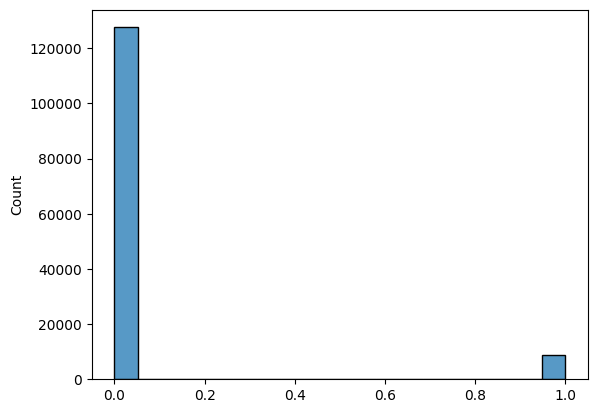

In [21]:
print((
    np.min(np.abs(raw_counts[:5].todense() % 1.)),
    np.max(np.abs(raw_counts[:5].todense() % 1.))
))
sb.histplot(np.asarray(np.abs(raw_counts[:5].todense() % 1.)).flatten())

In [22]:
raw_counts = round(raw_counts)

In [23]:
raw_counts[:5].sum(1)

matrix([[9194.],
        [8405.],
        [7914.],
        [5202.],
        [4754.]], dtype=float32)

In [24]:
adata_spots.raw = anndata.AnnData(
    raw_counts,
    var=adata_spots.raw.var,
    obs=pd.DataFrame({}, index=adata_spots.obs_names)
)

# Make unique segment IDs

In [25]:
adata_spots.obs["segment_id"] = [
    id_follicle if id_follicle != "other" else
    id_corpusluteum if id_corpusluteum != "other" else
    id_theca if id_theca != "other" else
    id_immune if id_immune != "other" else
    id_vascular if id_vascular != "other" else "other"
    for (
        id_follicle,
        id_corpusluteum,
        id_theca,
        id_immune,
        id_vascular
    ) in zip(
        adata_spots.obs["id_follicle"].values,
        adata_spots.obs["id_corpusluteum"].values,
        adata_spots.obs["id_theca"].values,
        adata_spots.obs["id_immune"].values,
        adata_spots.obs["id_vascular"].values,
    )
]

In [26]:
adata_spots.obs["segment_layer"] = [
    "granulosa" if id_follicle != "other" else
    "granulosa" if id_corpusluteum != "other" else
    "theca" if id_theca != "other" else
    "immune" if id_immune != "other" else
    "vascular" if id_vascular != "other" else "other"
    for (
        id_follicle,
        id_corpusluteum,
        id_theca,
        id_immune,
        id_vascular
    ) in zip(
        adata_spots.obs["id_follicle"].values,
        adata_spots.obs["id_corpusluteum"].values,
        adata_spots.obs["id_theca"].values,
        adata_spots.obs["id_immune"].values,
        adata_spots.obs["id_vascular"].values,
    )
]

# Create segment objects

## Utils

In [27]:
def load_mean_expression_from_raw(adata, partitions, obs_key, normalize_spots=False, exp=False):
    x_mean = []
    for x in partitions:
        # WARNING: cropping some spot names here as there is an apparent length mismatch, check this.
        #x = ["-".join(y.split("-")[:4]) for y in x]
        y = adata.raw.X     
        idx = np.where(x == adata.obs[obs_key].values)[0]
        if len(idx) > 0:
            y = y[idx, :]
            if exp:
                y = np.expm1(y)
            if normalize_spots:
                y = y / np.maximum(y.sum(1), 1) * 10000
            x_mean_i = np.asarray(y.mean(0)).flatten()
        else:
            x_mean_i = np.zeros((y.shape[1],))
        x_mean.append(x_mean_i)
    x_mean = np.vstack(x_mean)
    return x_mean

## Load

In [28]:
segment_ids = [
    x for x in np.unique(adata_spots.obs["segment_id"].values)
    if x != "other"
]
x_ave = load_mean_expression_from_raw(
    adata_spots, 
    partitions=segment_ids, 
    obs_key="segment_id", 
    normalize_spots=True, exp=False)

In [29]:
adata_segments = anndata.AnnData(pd.DataFrame(
    x_ave,
    index=segment_ids,
    columns=adata_spots.raw.var_names
))

In [30]:
adata_segments.X.sum(1)[:10]

array([10000.   , 10000.001, 10000.   , 10000.   , 10000.001, 10000.001,
       10000.   , 10000.001, 10000.   , 10000.001], dtype=float32)

In [31]:
for x in ["Age", "stage", "batch", "tissue", "puck"]:
    adata_segments.obs[x.lower()] = [
        adata_spots[adata_spots.obs["segment_id"].values == y].obs[x].values[0]
        for y in adata_segments.obs_names
    ]

In [32]:
adata_segments.obs['count_granulosa'] = [
    np.sum(np.logical_and(
        adata_spots.obs["segment_id"].values == x,
        adata_spots.obs["segment_layer"].values == "granulosa",
    ))
    for x in adata_segments.obs_names
]
adata_segments.obs['count_immune'] = [
    np.sum(np.logical_and(
        adata_spots.obs["segment_id"].values == x,
        adata_spots.obs["segment_layer"].values == "immune",
    ))
    for x in adata_segments.obs_names
]
adata_segments.obs['count_vascular'] = [
    np.sum(np.logical_and(
        adata_spots.obs["segment_id"].values == x,
        adata_spots.obs["segment_layer"].values == "vascular",
    ))
    for x in adata_segments.obs_names
]

In [33]:
for x in ["count_granulosa", "count_immune", "count_vascular"]:
    adata_segments.obs[f"{x}_log10"] = np.log(adata_segments.obs[x].values + 1) / np.log(10)

# Annotate segments

## Annotate basic

In [34]:
# segment cluster naming map:
cell_types_composition = {
    'follicle - preantral': ['GC - preantral', 'Oocyte - cumulus'],
    'follicle - antral early mitotic': ['GC - antral early mitotic'],
    'follicle - antral mitotic': ['GC - antral mitotic'],
    'follicle - antral luteinizing': ['GC - antral luteinizing'],
    'follicle - atretic': ['GC - atretic'],
    'CL - early': ['Luteal - early'],
    'CL - late': ['Luteal - late'],
}

map_label = {
    'follicle - preantral': 'follicle - preantral', 
    'follicle - antral mitotic': 'follicle - antral mitotic',
    'follicle - antral early mitotic': 'follicle - antral mitotic',
    'follicle - antral luteinizing': 'follicle - antral luteinizing',
    'follicle - atretic': 'follicle - atretic',
    'CL - early': 'CL - early', 
    'CL - late': 'CL - late',
}
label_levels = [
    'follicle - preantral', 
    'follicle - antral mitotic',
    'follicle - antral luteinizing',
    'follicle - atretic',
    'CL - early', 
    'CL - late']

map_label_coarse = {
    'follicle - preantral': 'follicle - preantral', 
    'follicle - antral mitotic': 'follicle - antral',
    'follicle - antral luteinizing': 'follicle - antral',
    'follicle - atretic': 'follicle - atretic',
    'CL - early': 'CL - early', 
    'CL - late': 'CL - late',
}
label_levels_coarse = [
    'follicle - preantral', 
    'follicle - antral',
    'follicle - atretic',
    'CL - early', 
    'CL - late']

segment_label_colors_dict={
    'follicle - preantral': '#C8BEFA',
    'follicle - atretic': '#FA7850',
    'follicle - antral mitotic': '#AA0A3C',
    'follicle - antral luteinizing': '#006E82',
    'CL - early': '#E69F00',
    'CL - late': '#8214A0'
}
segment_label_coarse_colors_dict={
    'follicle - preantral': '#C8BEFA',
    'follicle - atretic': '#FA7850',
    'follicle - antral': '#006E82',
    'CL - early': '#E69F00',
    'CL - late': '#8214A0'
}

In [35]:
adata_segments.obsm["spot_label_composition"] = pd.DataFrame(
    np.zeros((len(adata_segments.obs_names), len(cell_types_composition.keys()))),
    index=adata_segments.obs_names, columns=list(cell_types_composition.keys())
)
adata_segments.obsm["spot_label_counts"] = pd.DataFrame(
    np.zeros((len(adata_segments.obs_names), len(cell_types_composition.keys()))),
    index=adata_segments.obs_names, columns=list(cell_types_composition.keys())
)
tab = adata_spots.obs[["segment_id", cell_type_col]].value_counts().reset_index()
# Normalize fractions in granulosa cell types
tab = tab.loc[[
    np.any([x in y for y in cell_types_composition.values()]) 
    for x in tab[cell_type_col].values
]].copy()
for x in adata_segments.obs_names:
    nx = tab.loc[tab["segment_id"].values == x, "count"].values
    nx = np.sum(nx) if len(nx) > 0 else 0
    if nx > 0:
        for k, v in cell_types_composition.items():
            nxy = tab.loc[np.logical_and(
                tab["segment_id"].values == x,
                [y in v for y in tab[cell_type_col].values]
            ), "count"].values
            nxy = np.sum(nxy) if len(nxy) > 0 else 0
            adata_segments.obsm["spot_label_composition"].loc[x, k] = nxy / nx
            adata_segments.obsm["spot_label_counts"].loc[x, k] = nxy
del tab

0.0
1.0
1.0000000000000002


<Axes: ylabel='Count'>

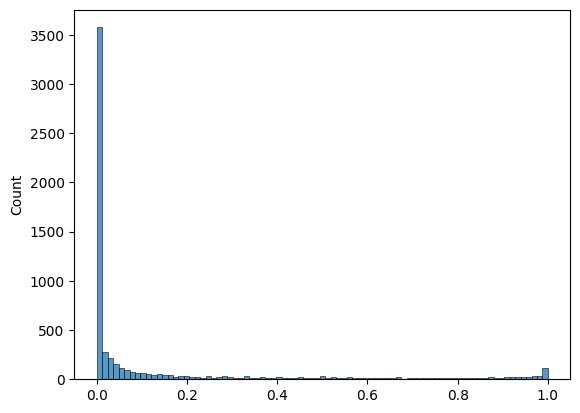

In [36]:
print(np.min(adata_segments.obsm["spot_label_composition"]))
print(np.max(adata_segments.obsm["spot_label_composition"]))
print(np.max(adata_segments.obsm["spot_label_composition"].sum(1)))
sb.histplot(adata_segments.obsm["spot_label_composition"].values.flatten())

In [37]:
pseudocount = 1e-3
x = adata_segments.obsm["spot_label_composition"] + pseudocount
gmean = scipy.stats.gmean(x, axis=1, keepdims=True)
adata_segments.obsm["spot_label_composition_clr"] = np.log(x / gmean)
adata_segments.obsm["spot_label_composition_clr"]

,follicle - preantral,follicle - antral early mitotic,follicle - antral mitotic,follicle - antral luteinizing,follicle - atretic,CL - early,CL - late
corpusluteum_A0029_020_0,-1.657319,-1.657319,-1.657319,-1.657319,-1.657319,3.166812,5.119783
corpusluteum_A0029_026_0_0,-0.584057,-0.925047,-0.330241,-0.925047,-0.925047,-0.584057,4.273495
corpusluteum_A0029_026_0_5,-1.265559,-1.265559,1.016320,-1.265559,-1.265559,3.343447,0.702469
corpusluteum_A0029_026_1_0,-0.813207,-1.345737,1.649363,-2.560551,-1.345737,4.253940,0.161929
corpusluteum_A0029_026_2,-0.986965,-0.986965,-0.986965,-0.986965,-0.986965,-0.986965,5.921790
...,...,...,...,...,...,...,...
follicle_Puck_240129_37_6_0,3.233173,-2.425314,-2.425314,-2.425314,-2.425314,3.924574,2.543507
follicle_Puck_240129_37_6_1,5.921790,-0.986965,-0.986965,-0.986965,-0.986965,-0.986965,-0.986965
follicle_Puck_240129_37_6_m,3.209595,-2.315858,-2.315858,1.835182,4.218657,-2.315858,-2.315858
follicle_Puck_240129_37_8,4.774881,-2.046953,-2.046953,-2.046953,-2.046953,1.706465,1.706465


In [38]:
for k, v in adata_segments.obsm["spot_label_composition"].items():
    adata_segments.obs[f"n_spots_{k}"] = v

In [39]:
# Choose label based on most common spot group:
adata_segments.obs["segment_label_max"] = pd.Categorical([
    adata_segments.obsm["spot_label_composition"].columns[np.argmax(x.values)]
    for (_, x), (_, y) in zip(
        adata_segments.obsm["spot_label_composition"].iterrows(),
        adata_segments.obsm["spot_label_counts"].iterrows()
    )
], categories=label_levels)

/Users/fischer/opt/miniconda3/envs/ovary/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


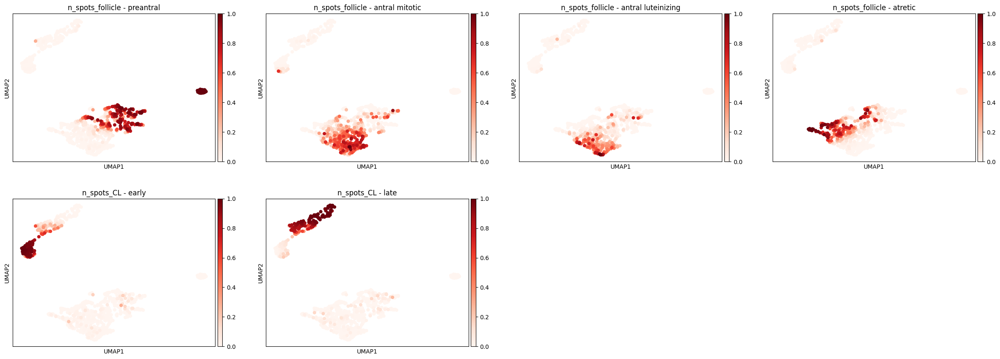

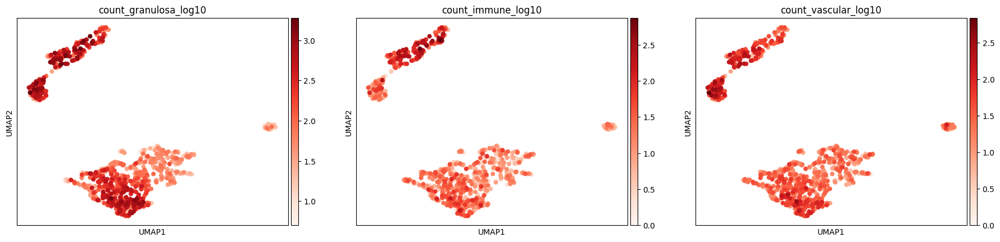

In [40]:
# Cluster composition and embed in CLR
#sc.pp.neighbors(adata_segments, use_rep="spot_label_composition")
#sc.tl.leiden(adata_segments, resolution=1.5)
sc.pp.neighbors(adata_segments, use_rep="spot_label_composition_clr")
sc.tl.umap(adata_segments)
sc.pl.umap(adata_segments, color=[f"n_spots_{k}" for k in label_levels], save="_segments_granulosacomposition.pdf", cmap="Reds")
sc.pl.umap(adata_segments, color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_segments_coarsecomposition.pdf", cmap="Reds")

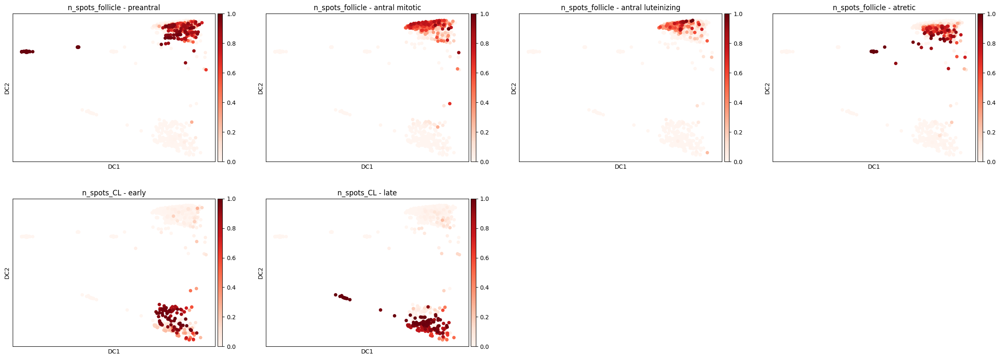

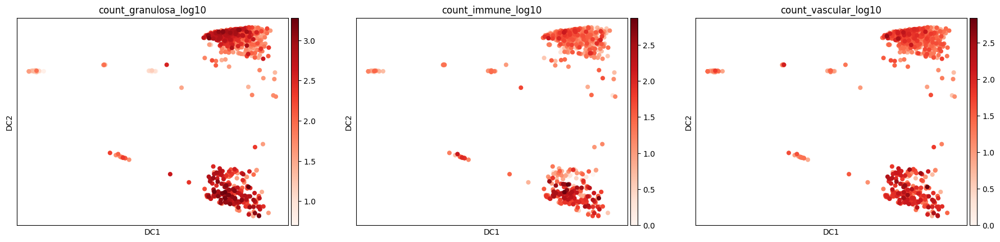

In [41]:
sc.tl.diffmap(adata_segments)
sc.pl.diffmap(adata_segments, color=[f"n_spots_{k}" for k in label_levels], save="_segments_granulosacomposition.pdf", cmap="Reds")
sc.pl.diffmap(adata_segments, color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_segments_coarsecomposition.pdf", cmap="Reds")

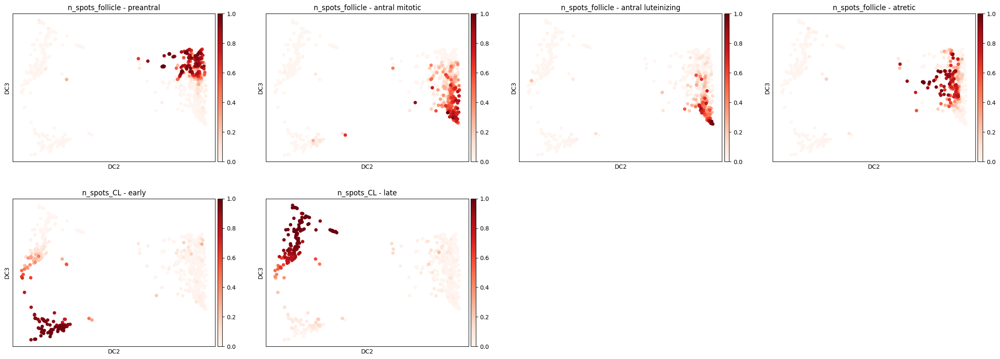

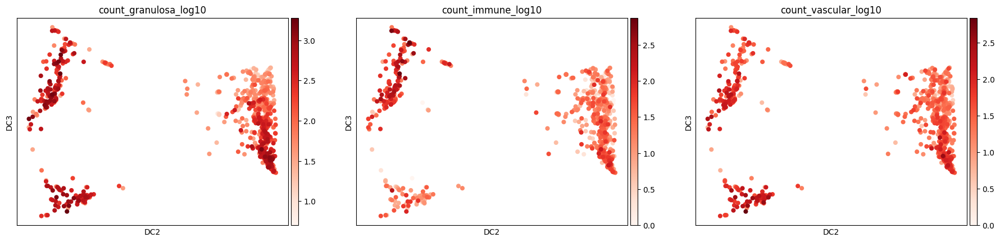

In [42]:
sc.pl.diffmap(adata_segments, components="2,3", color=[f"n_spots_{k}" for k in label_levels], save="_c23_segments_granulosacomposition.pdf", cmap="Reds")
sc.pl.diffmap(adata_segments, components="2,3", color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_c23_segments_coarsecomposition.pdf", cmap="Reds")

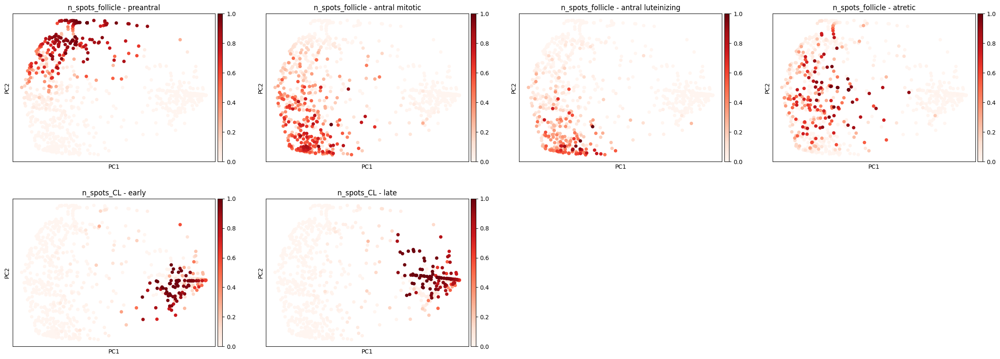

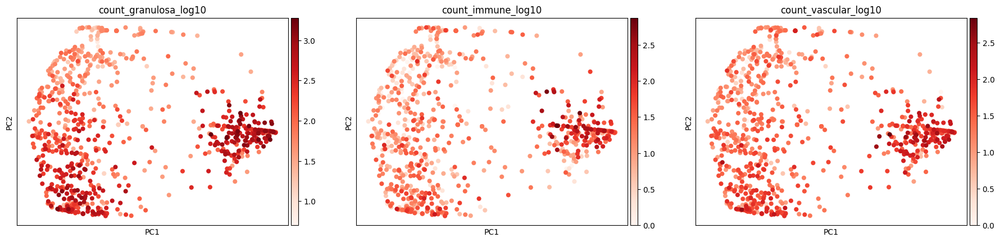

In [43]:
adata_segments.obsm["X_pca"] = sc.tl.pca(adata_segments.obsm["spot_label_composition_clr"].values)
sc.pl.pca(adata_segments, color=[f"n_spots_{k}" for k in label_levels], save="_segments_granulosacomposition.pdf", cmap="Reds")
sc.pl.pca(adata_segments, color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_segments_coarsecomposition.pdf", cmap="Reds")

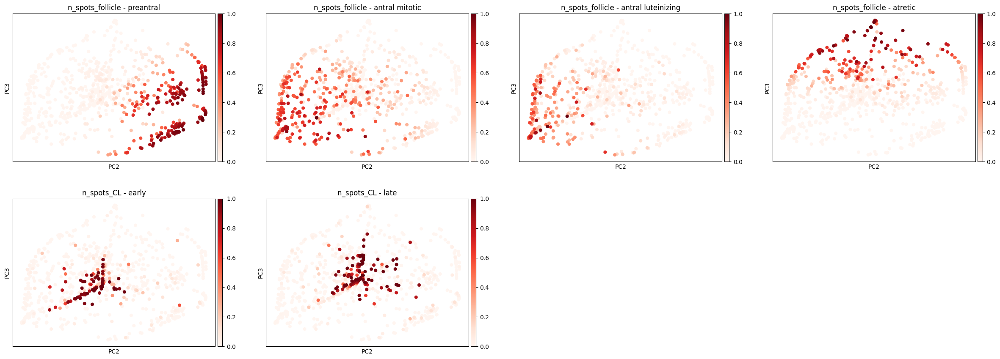

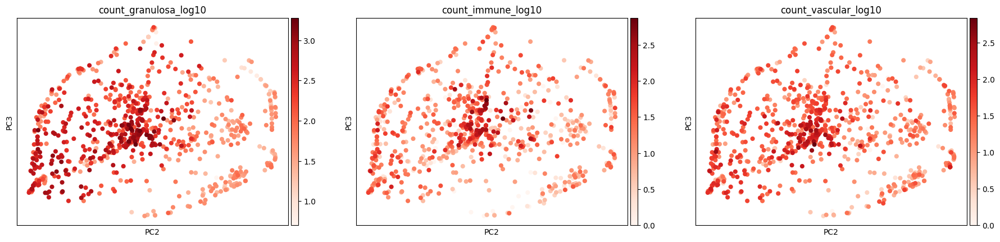

In [44]:
sc.pl.pca(adata_segments, components="2,3", color=[f"n_spots_{k}" for k in label_levels], save="_c23_segments_granulosacomposition.pdf", cmap="Reds")
sc.pl.pca(adata_segments, components="2,3", color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_c23_segments_coarsecomposition.pdf", cmap="Reds")

In [45]:
list(adata_segments.obsm["spot_label_composition"].iterrows())[0][1]["follicle - atretic"]

0.0

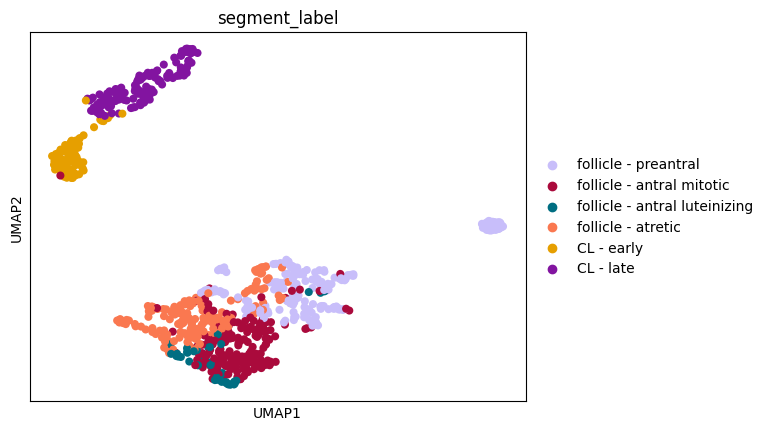

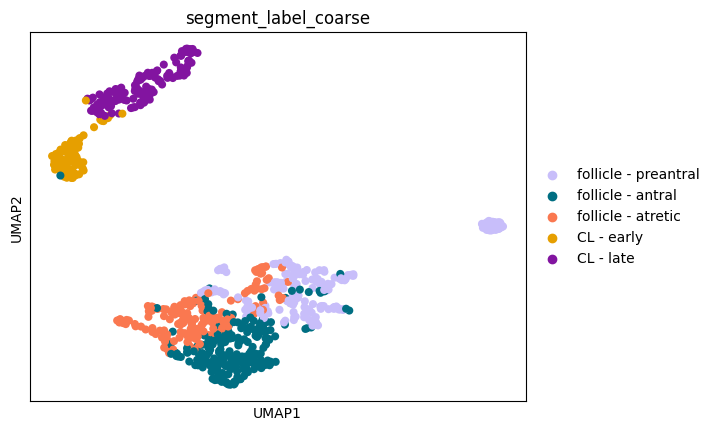

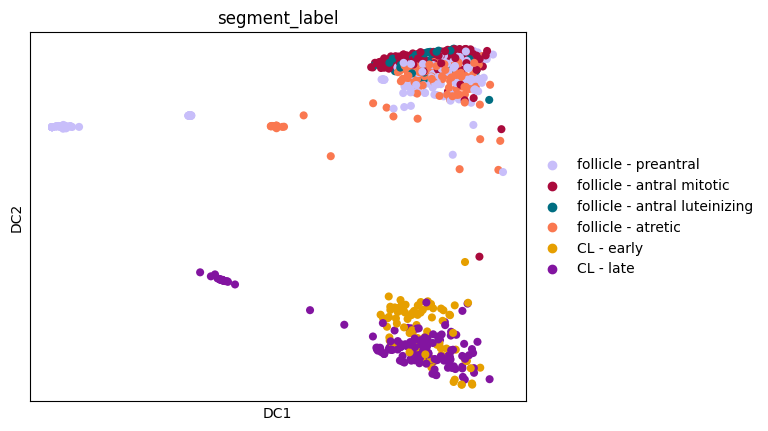

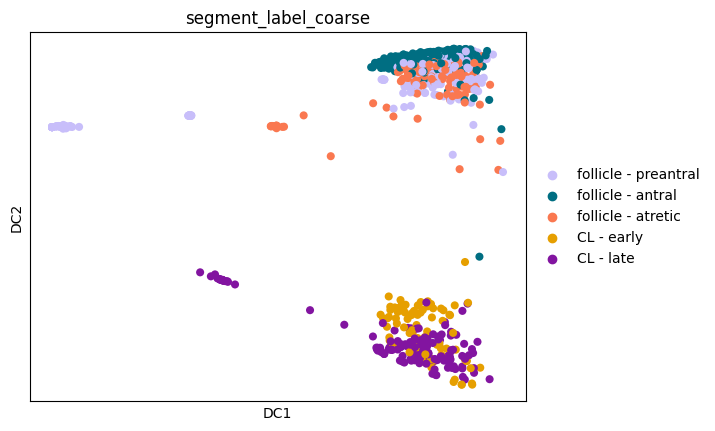

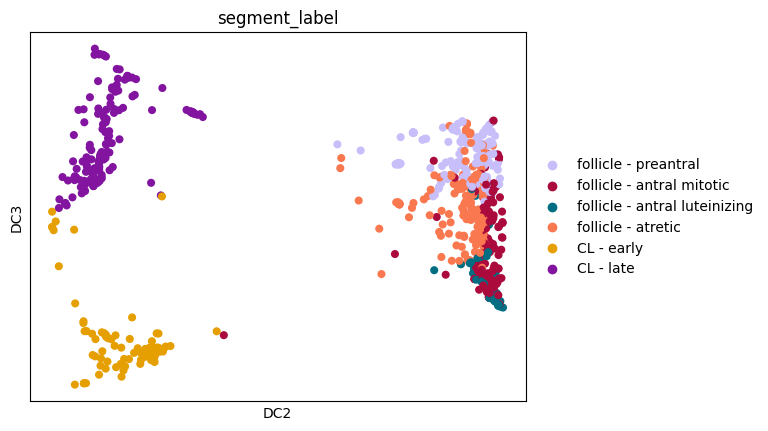

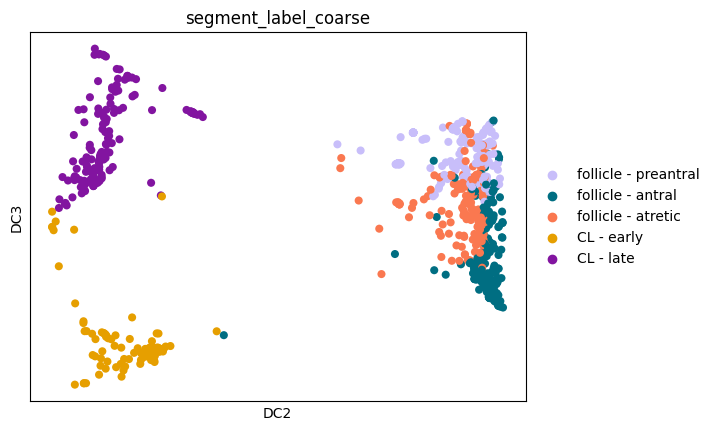

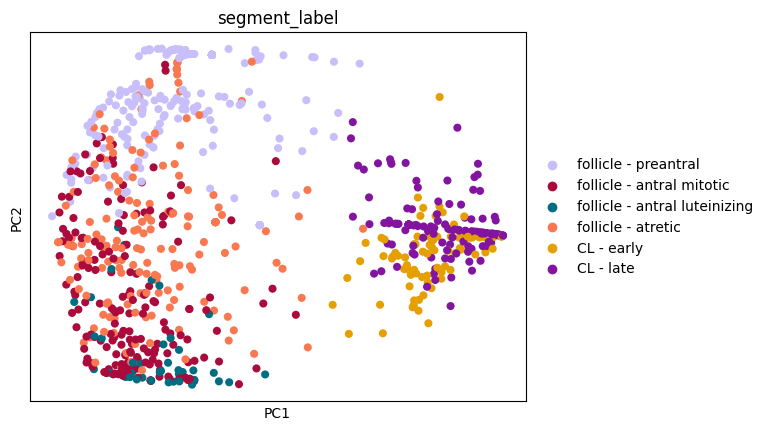

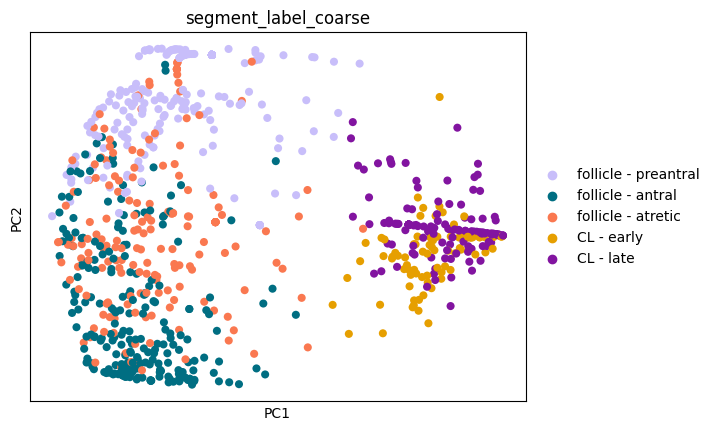

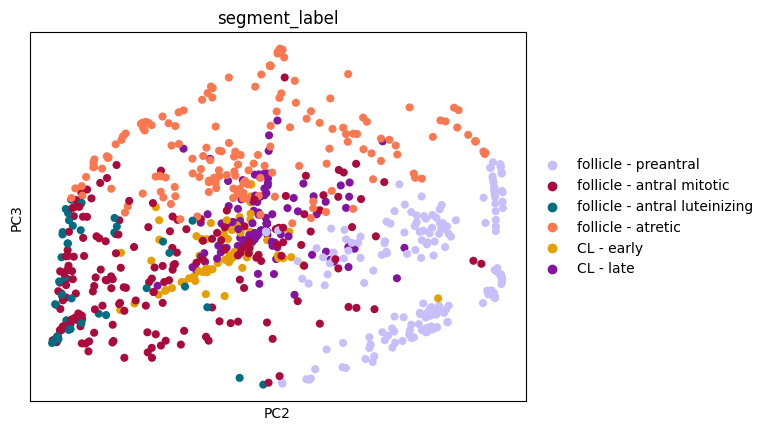

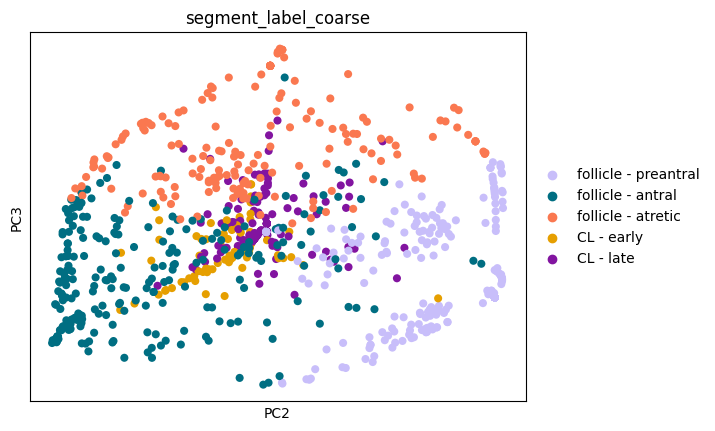

In [46]:
# cluster_names = {}
# cols = adata_segments.obsm["spot_label_composition"].columns
# for k in np.unique(adata_segments.obs["leiden"].values):
#     mean_comp = adata_segments[adata_segments.obs["leiden"].values == k].obsm["spot_label_composition"].mean(0)
#     # Chose maximum abundant group unless lutenizing is >=x%:
#     cluster_names[k] = map_label[
#         cols[np.argmax(mean_comp)] if mean_comp["follicle - antral luteinizing"] < 0.2 else 
#         "follicle - antral luteinizing"
#     ]
#     # cluster_names[k] = map_label[cols[np.argmax(mean_comp)]]
# # Relabel those that clustered as CL purely based on majority of either type as this is just a 2D problem:
# adata_segments.obs["segment_label"] = pd.Categorical([
#     cluster_names[x] if not cluster_names[x].startswith("CL") else
#     "CL - early" if y/(y+z) > 0.5 else "CL - late"
#     for x, y, z in zip(
#         adata_segments.obs["leiden"].values,
#         adata_segments.obsm["spot_label_composition"]["CL - early"].values,
#         adata_segments.obsm["spot_label_composition"]["CL - late"].values,
#     )
# ], categories=label_levels)
# adata_segments.obs["segment_label_coarse"] = pd.Categorical([
#     map_label_coarse[x] for x in adata_segments.obs["segment_label"].values
# ], categories=label_levels_coarse)
# sc.pl.umap(adata_segments, color="leiden")
# sc.pl.umap(adata_segments, color="segment_label", save="_segments_label.pdf")
# sc.pl.umap(adata_segments, color="segment_label_coarse", save="_segments_label_coarse.pdf")

max_label = [
    adata_segments.obsm["spot_label_composition"].columns[np.argmax(x)]
    for x in adata_segments.obsm["spot_label_composition"].values
]
# Could consider this update:
# adata_segments.obs["segment_label"] = pd.Categorical([
#     map_label[
#         "follicle - atretic" if y[1]["follicle - atretic"] > 0.2 else
#         x if not x.startswith("CL") and ze+zl <= 0.5 else
#         "CL - early" if ze/(ze+zl) > 0.5 else "CL - late"
#     ]
#     for x, y, ze, zl in zip(
#         max_label,
#         adata_segments.obsm["spot_label_composition"].iterrows(),
#         adata_segments.obsm["spot_label_composition"]["CL - early"].values,
#         adata_segments.obsm["spot_label_composition"]["CL - late"].values,
#     )
# ], categories=label_levels)
adata_segments.obs["segment_label"] = pd.Categorical([
    map_label[
        "follicle - atretic" if y[1]["follicle - atretic"] > 0.2 else
        x if not x.startswith("CL") and ze+zl <= 0.5 else
        "CL - early" if ze/(ze+zl) > 0.5 else "CL - late"
    ]
    for x, y, ze, zl in zip(
        max_label,
        adata_segments.obsm["spot_label_composition"].iterrows(),
        adata_segments.obsm["spot_label_composition"]["CL - early"].values,
        adata_segments.obsm["spot_label_composition"]["CL - late"].values,
    )
], categories=label_levels)
adata_segments.obs["segment_label_coarse"] = pd.Categorical([
    map_label_coarse[x] for x in adata_segments.obs["segment_label"].values
], categories=label_levels_coarse)
sc.pl.umap(adata_segments, color="segment_label", save="_segments_label.pdf", palette=segment_label_colors_dict)
sc.pl.umap(adata_segments, color="segment_label_coarse", save="_segments_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.diffmap(adata_segments, color="segment_label", save="_segments_label.pdf", palette=segment_label_colors_dict)
sc.pl.diffmap(adata_segments, color="segment_label_coarse", save="_segments_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.diffmap(adata_segments, components="2,3", color="segment_label", save="_c23_segments_label.pdf", palette=segment_label_colors_dict)
sc.pl.diffmap(adata_segments, components="2,3", color="segment_label_coarse", save="_c23_segments_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.pca(adata_segments, color="segment_label", save="_segments_label.pdf", palette=segment_label_colors_dict)
sc.pl.pca(adata_segments, color="segment_label_coarse", save="_segments_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.pca(adata_segments, components="2,3", color="segment_label", save="_c23_segments_label.pdf", palette=segment_label_colors_dict)
sc.pl.pca(adata_segments, components="2,3", color="segment_label_coarse", save="_c23_segments_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

In [47]:
adata_segments.obs.groupby(["segment_label"]).size().reset_index()

,segment_label,0
0,follicle - preantral,238
1,follicle - antral mitotic,191
2,follicle - antral luteinizing,43
3,follicle - atretic,181
4,CL - early,87
5,CL - late,147


In [48]:
adata_segments.obs.groupby(["segment_label"])["count_granulosa"].mean().reset_index()

,segment_label,count_granulosa
0,follicle - preantral,36.743697
1,follicle - antral mitotic,317.335079
2,follicle - antral luteinizing,245.534884
3,follicle - atretic,144.348066
4,CL - early,463.229885
5,CL - late,410.129252


In [49]:
(
    adata_segments.obs.groupby(["segment_label", "stage"]).size() /
    adata_segments.obs.groupby(["stage"]).size()
).reset_index()

,segment_label,stage,0
0,follicle - preantral,Estrus,0.287958
1,follicle - preantral,Metestrus,0.232484
2,follicle - antral mitotic,Estrus,0.219895
3,follicle - antral mitotic,Metestrus,0.207006
4,follicle - antral luteinizing,Estrus,0.034904
5,follicle - antral luteinizing,Metestrus,0.073248
6,follicle - atretic,Estrus,0.183246
7,follicle - atretic,Metestrus,0.242038
8,CL - early,Estrus,0.125654
9,CL - early,Metestrus,0.047771


In [50]:
(
    adata_segments.obs.groupby(["segment_label", "age"]).size() /
    adata_segments.obs.groupby(["age"]).size()
).reset_index()

,segment_label,age,0
0,follicle - preantral,Middle,0.297778
1,follicle - preantral,Old,0.142105
2,follicle - preantral,Young,0.305085
3,follicle - antral mitotic,Middle,0.217778
4,follicle - antral mitotic,Old,0.215789
5,follicle - antral mitotic,Young,0.213983
6,follicle - antral luteinizing,Middle,0.066667
7,follicle - antral luteinizing,Old,0.078947
8,follicle - antral luteinizing,Young,0.027542
9,follicle - atretic,Middle,0.217778


In [51]:
# tab = adata_segments.obsm["spot_label_composition"].copy()
# tab["segment_label"] = adata_segments.obs["segment_label"].values
# tab = tab.melt(var_name="spot_label", value_name="fraction", id_vars="segment_label")

# fig, ax = plt.subplots(1, 1, figsize=(12, 4))
# sb.boxplot(
#     data=tab,
#     x="segment_label",
#     y="fraction",
#     hue="spot_label",
#     ax=ax,
#     palette=segment_label_colors_dict,
# )
# sb.move_legend(ax, "right", bbox_to_anchor=(1.3, 0.5))
# ax.tick_params(axis='x', labelrotation=45)
# plt.tight_layout()
# plt.savefig(os.path.join(figure_folder, f"boxplot_composition_by_segment_cluster.pdf"))
# plt.show()

## Separate follicles and CL 

In [52]:
adata_segments.obs["segment_type"] = [
    "small follicle" if x.startswith("follicle") and y < 20 else
    "follicle" if x.startswith("follicle") else
    "corpus luteum" if x.startswith("CL") else "error"
    for x, y in zip(
        adata_segments.obs["segment_label"].values,
        adata_segments.obs["count_granulosa"].values
    )
]

In [53]:
adata_follicles = adata_segments[adata_segments.obs["segment_type"].values == "follicle"].copy()
adata_cl = adata_segments[adata_segments.obs["segment_type"].values == "corpus luteum"].copy()

## Follicles only

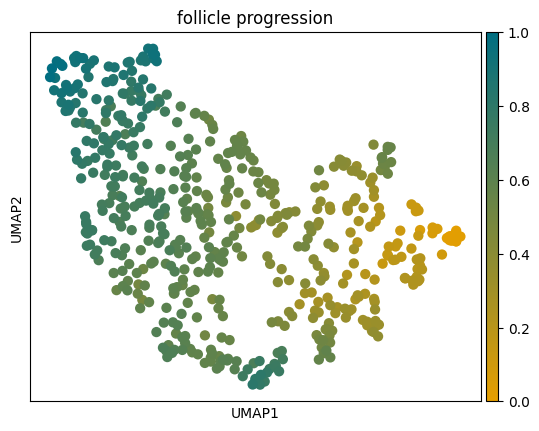

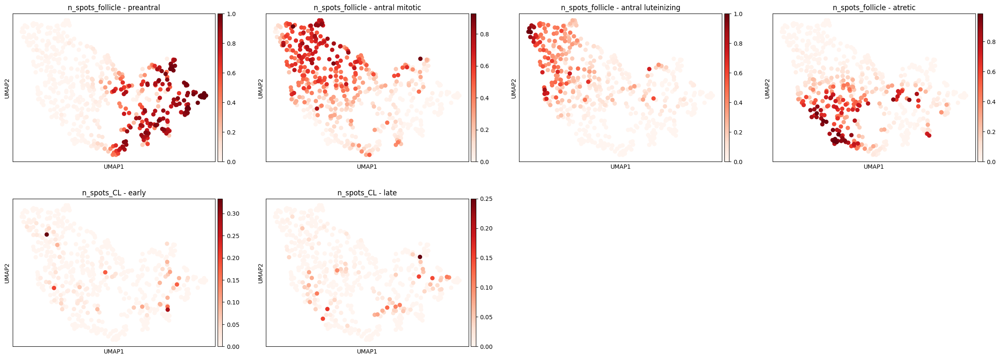

In [54]:
# Choose label based on clustering
sc.pp.neighbors(adata_follicles, use_rep="spot_label_composition_clr")
sc.tl.leiden(adata_follicles)

adata_follicles.uns["iroot"] = np.argmax(adata_follicles.obs["n_spots_follicle - preantral"].values)
sc.tl.diffmap(adata_follicles)
sc.tl.dpt(adata_follicles)
adata_follicles.obs["follicle progression"] = adata_follicles.obs["dpt_pseudotime"].values

sc.tl.umap(adata_follicles)
sc.pl.umap(adata_follicles, color="follicle progression", save="_follicles_progression.pdf", cmap=cmap_pseudotime)
sc.pl.umap(adata_follicles, color=[f"n_spots_{k}" for k in label_levels], save="_follicles_granulosacomposition.pdf", cmap="Reds")

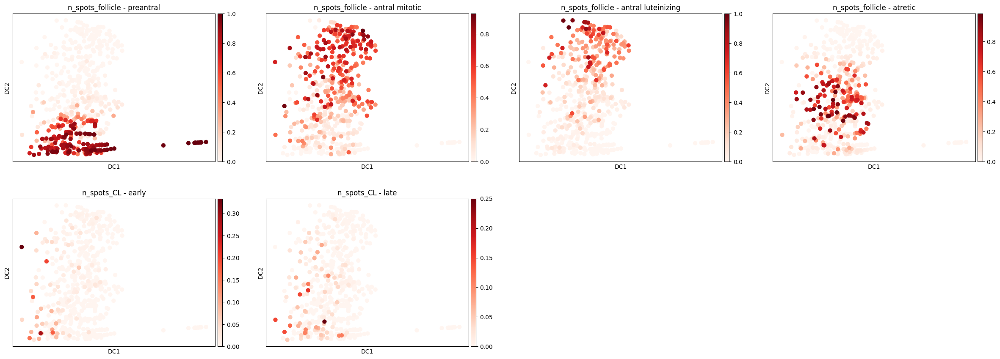

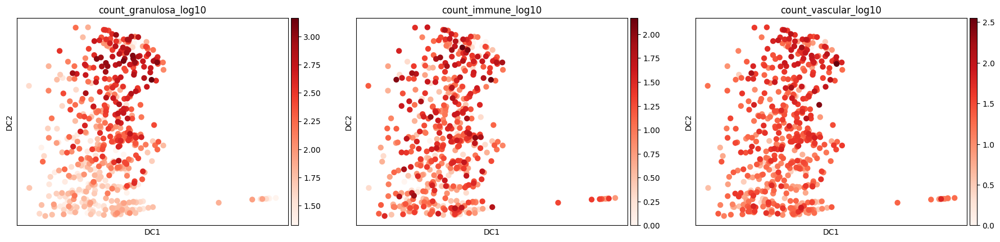

In [55]:
sc.tl.diffmap(adata_follicles)
sc.pl.diffmap(adata_follicles, color=[f"n_spots_{k}" for k in label_levels], save="_follicles_granulosacomposition.pdf", cmap="Reds")
sc.pl.diffmap(adata_follicles, color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_follicles_coarsecomposition.pdf", cmap="Reds")

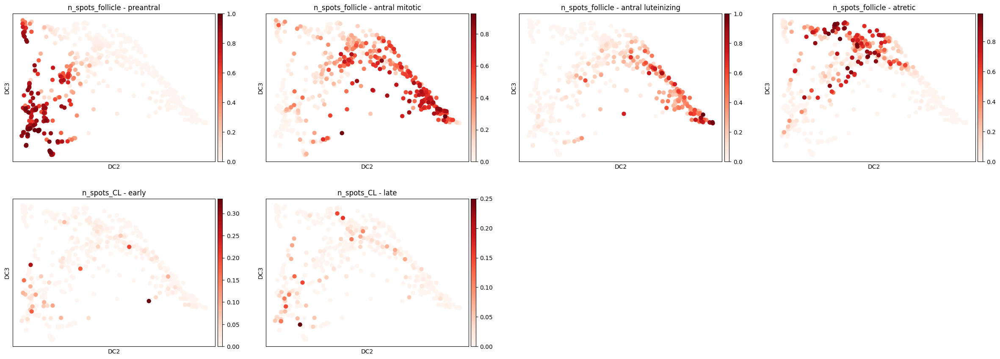

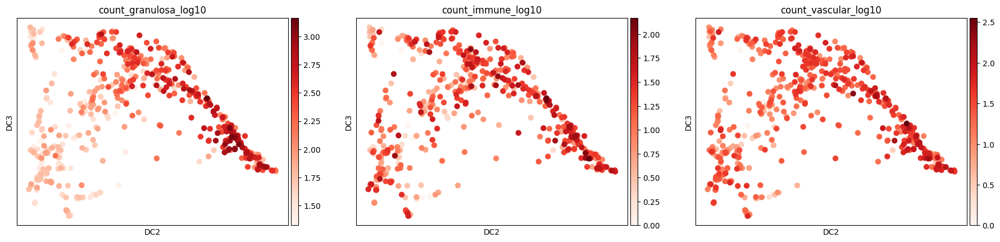

In [56]:
sc.pl.diffmap(adata_follicles, components="2,3", color=[f"n_spots_{k}" for k in label_levels], save="_c23_follicles_granulosacomposition.pdf", cmap="Reds")
sc.pl.diffmap(adata_follicles, components="2,3", color=["count_granulosa_log10", "count_immune_log10", "count_vascular_log10"], save="_c23_follicles_coarsecomposition.pdf", cmap="Reds")

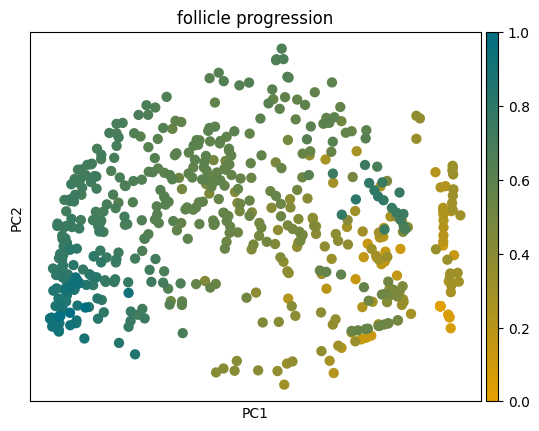

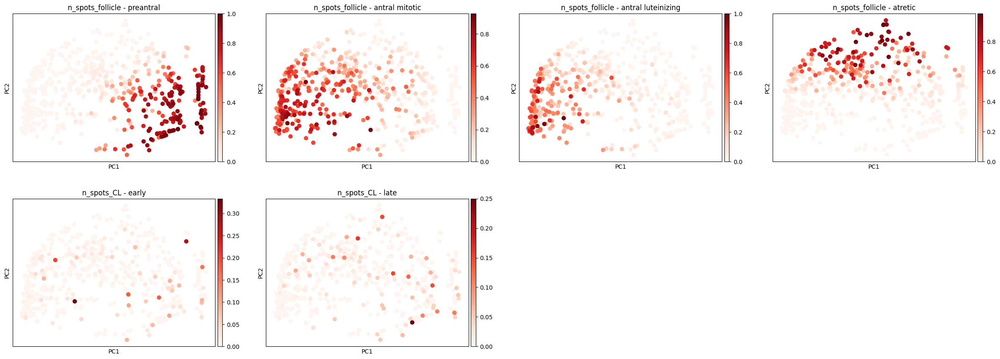

In [57]:
adata_follicles.obsm["X_pca"] = sc.tl.pca(adata_follicles.obsm["spot_label_composition_clr"].values)
sc.pl.pca(adata_follicles, color="follicle progression", save="_follicles_progression.pdf", cmap=cmap_pseudotime)
sc.pl.pca(adata_follicles, color=[f"n_spots_{k}" for k in label_levels], save="_follicles_granulosacomposition.pdf", cmap="Reds")

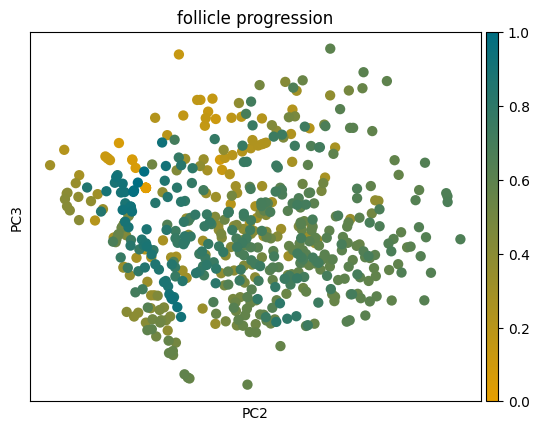

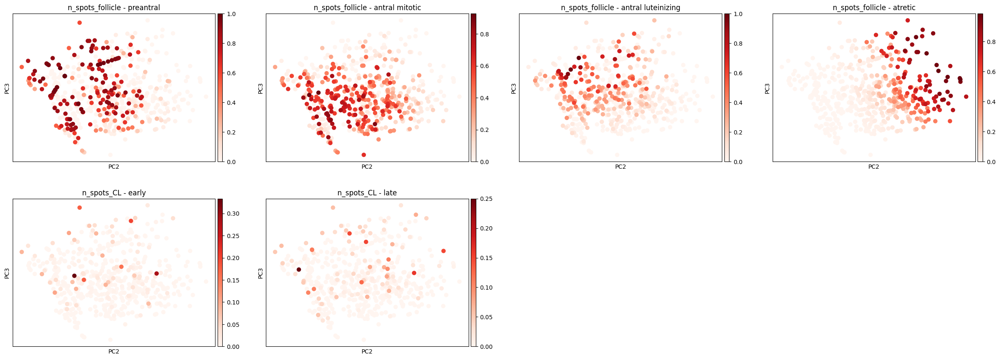

In [58]:
sc.pl.pca(adata_follicles, components="2,3", color="follicle progression", save="_c23_follicles_progression.pdf", cmap=cmap_pseudotime)
sc.pl.pca(adata_follicles, components="2,3", color=[f"n_spots_{k}" for k in label_levels], save="_c23_follicles_granulosacomposition.pdf", cmap="Reds")

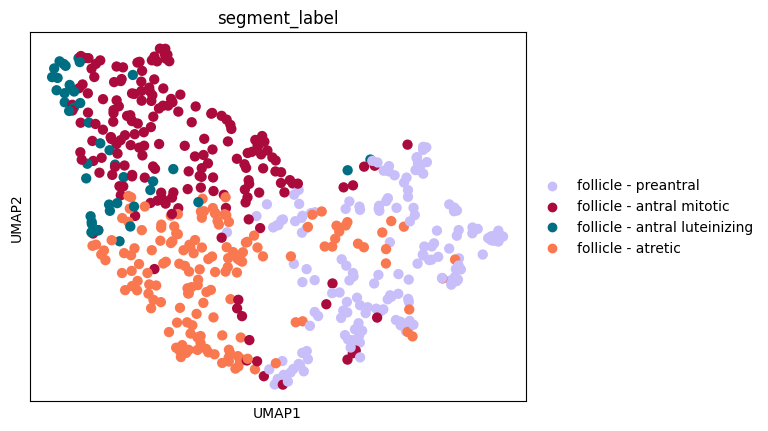

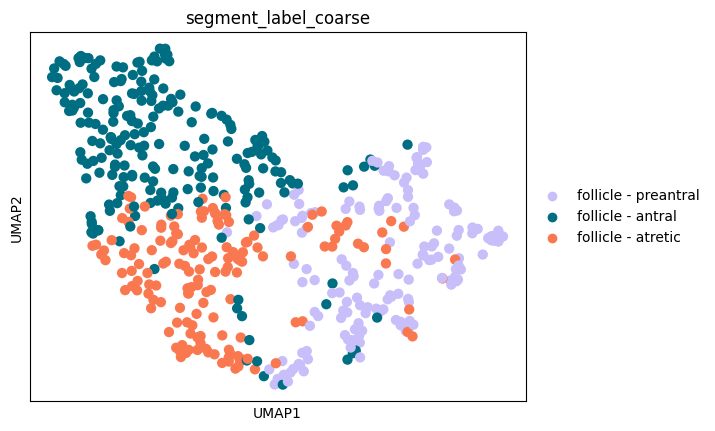

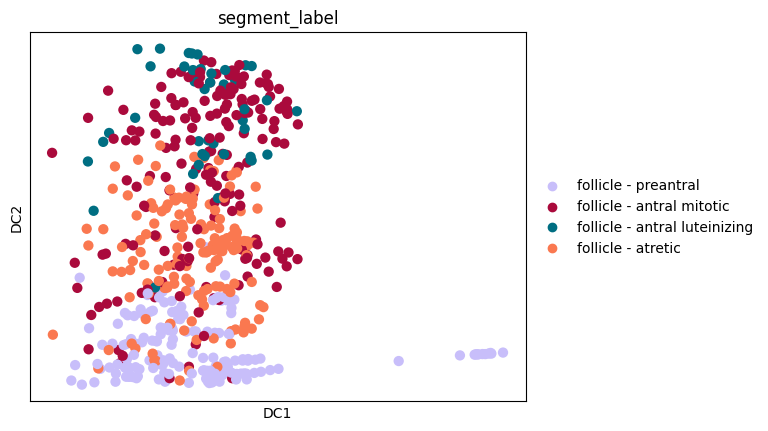

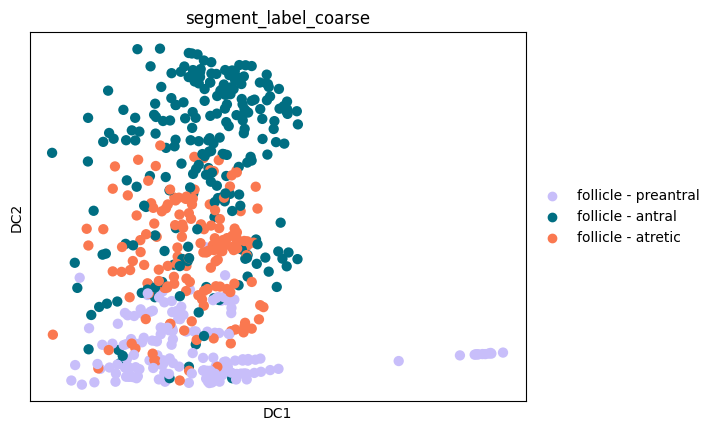

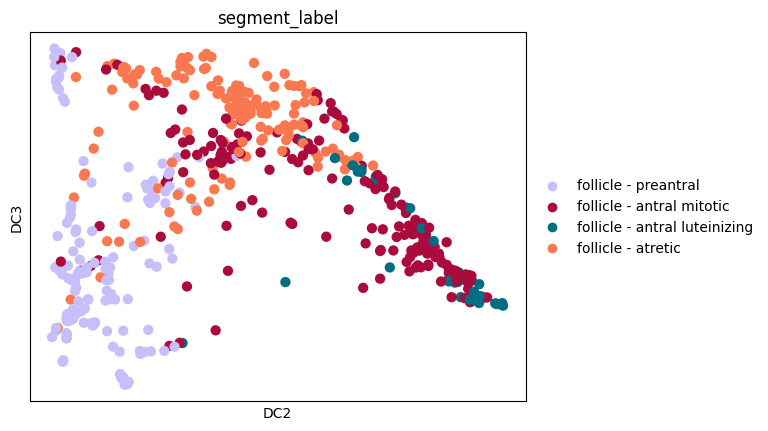

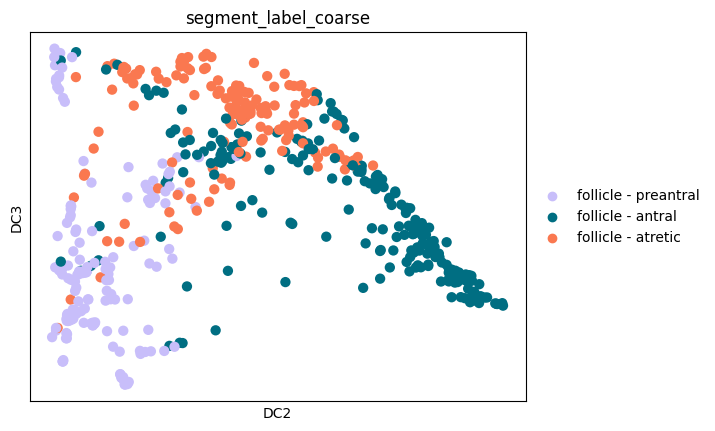

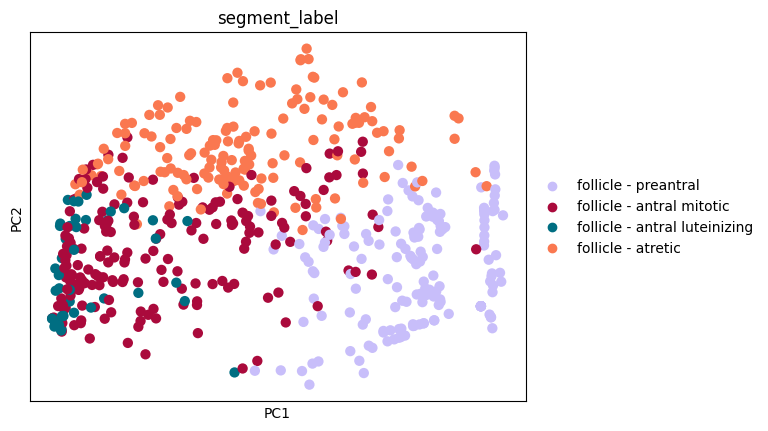

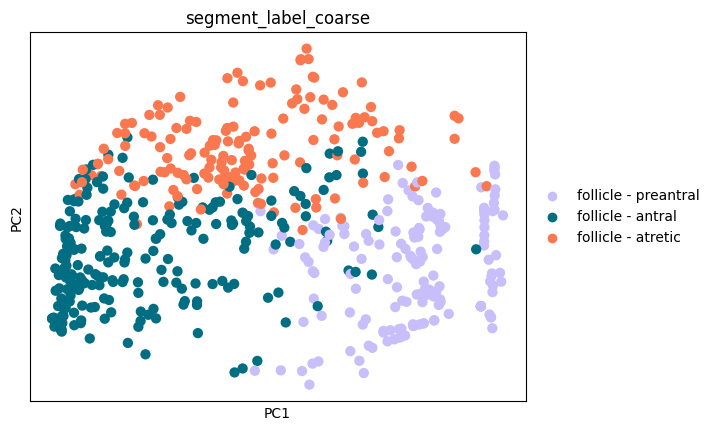

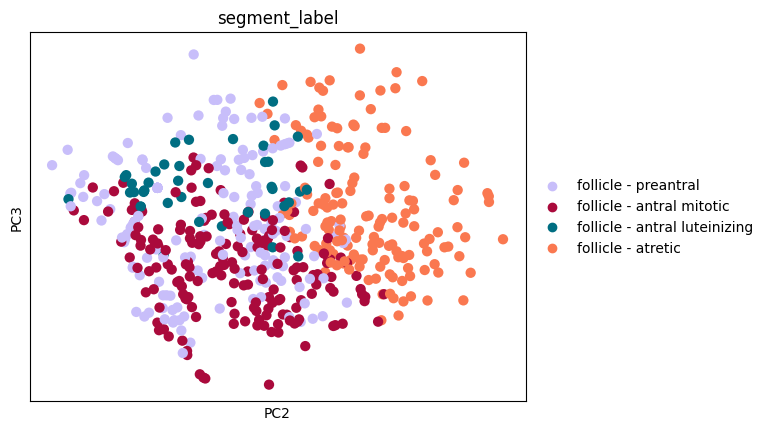

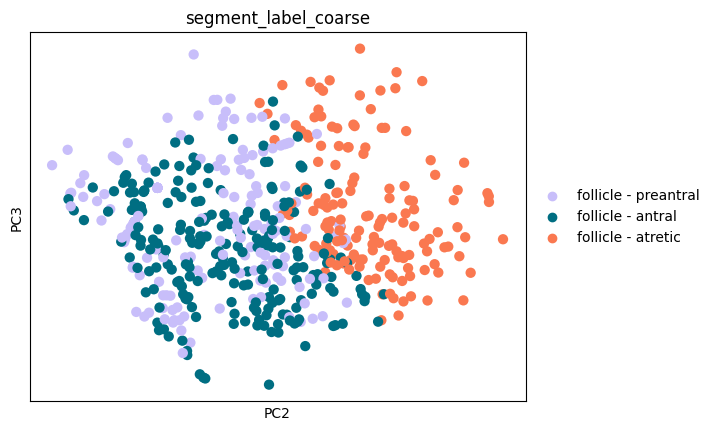

In [59]:
sc.pl.umap(adata_follicles, color="segment_label", save="_follicles_label.pdf", palette=segment_label_colors_dict)
sc.pl.umap(adata_follicles, color="segment_label_coarse", save="_follicles_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.diffmap(adata_follicles, color="segment_label", save="_follicles_label.pdf", palette=segment_label_colors_dict)
sc.pl.diffmap(adata_follicles, color="segment_label_coarse", save="_follicles_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.diffmap(adata_follicles, components="2,3", color="segment_label", save="_c23_follicles_label.pdf", palette=segment_label_colors_dict)
sc.pl.diffmap(adata_follicles, components="2,3", color="segment_label_coarse", save="_c23_follicles_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.pca(adata_follicles, color="segment_label", save="_follicles_label.pdf", palette=segment_label_colors_dict)
sc.pl.pca(adata_follicles, color="segment_label_coarse", save="_follicles_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

sc.pl.pca(adata_follicles, components="2,3", color="segment_label", save="_c23_follicles_label.pdf", palette=segment_label_colors_dict)
sc.pl.pca(adata_follicles, components="2,3", color="segment_label_coarse", save="_c23_follicles_label_coarse.pdf", palette=segment_label_coarse_colors_dict)

## CL only

In [60]:
adata_cl.obs["CL progression"] = adata_cl.obs["n_spots_CL - early"].values / (
    adata_cl.obs["n_spots_CL - early"].values + 
    adata_cl.obs["n_spots_CL - late"].values
)

## Add labels into full segment and spot objects

In [61]:
adata_segments.obs["CL progression"] = np.nan
adata_segments.obs.loc[adata_cl.obs_names, "CL progression"] = adata_cl.obs["CL progression"].values

adata_segments.obs["follicle progression"] = np.nan
adata_segments.obs.loc[adata_follicles.obs_names, "follicle progression"] = adata_follicles.obs["follicle progression"].values

for x in ["segment_label", "segment_label_coarse", "segment_type"]:
    m = dict(list(zip(adata_segments.obs_names, adata_segments.obs[x].values)))
    adata_spots.obs[x] = [
        m[y] if y != "other" else "other" for y in adata_spots.obs["segment_id"].values
    ]
adata_spots.obs["segment_label"] = pd.Categorical(adata_spots.obs["segment_label"].values, categories=label_levels + ["other"])
adata_spots.obs["segment_label_coarse"] = pd.Categorical(adata_spots.obs["segment_label_coarse"].values, 
                                                         categories=label_levels_coarse + ["other"])

## Plot labels in space

In [62]:
def plot_label_summary(x, adata, show=False, filetype="png"):
    slide = select_slide(adata, x)
    with warnings.catch_warnings():
        nrows = 2
        ncols = 3
        fig, ax = plt.subplots(
            nrows=nrows, ncols=ncols, 
            figsize=(ncols * 6, nrows * 4), 
        )

        # follicles
        i = 0
        j = 0
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, j])
        sc.pl.spatial(
            slide[np.logical_and(
                slide.obs["segment_type"].values == "follicle",
                slide.obs["segment_layer"].values == "granulosa",
            ), :],
            ncols=1, size=2, img_key=x, library_id=x,
            color="id_follicle",
            spot_size=20.,
            show=False, ax=ax[i, j])
        ax[i, j].set_title(f"{x}\nfollicle segments")
        ax[i, j].set_xlabel("")
        ax[i, j].set_ylabel("follicle\nspatial 2")
        ax[i, j].legend_.remove()
        j = 1
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, j])
        sc.pl.spatial(
            slide[[y.startswith("GC") or y.startswith("Cumulus") 
                   for y in slide.obs[cell_type_col].values], :],
            palette=cell_type_colors_dict,
            ncols=1, size=2, img_key=x, library_id=x,
            color=cell_type_col,
            spot_size=20.,
            show=False, ax=ax[i, j])
        ax[i, j].set_title(f"follicle spot clusters")
        ax[i, j].set_xlabel("")
        ax[i, j].set_ylabel("")
        j = 2
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, j])
        sc.pl.spatial(
            slide[slide.obs["segment_type"].values == "follicle", :], 
            palette=segment_label_colors_dict,
            ncols=1, size=2, img_key=x, library_id=x,
            color="segment_label",
            spot_size=20.,
            show=False, ax=ax[i, j])
        ax[i, j].set_title(f"follicle label")
        ax[i, j].set_xlabel("")
        ax[i, j].set_ylabel("")

        i = 1
        j = 0
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, j])
        sc.pl.spatial(
            slide[np.logical_and(
                slide.obs["segment_type"].values == "corpus luteum",
                slide.obs["segment_layer"].values == "granulosa",
            ), :],
            ncols=1, size=2, img_key=x, library_id=x,
            color="id_corpusluteum",
            spot_size=20.,
            show=False, ax=ax[i, j])
        ax[i, j].set_title("corpus luteum segments")
        ax[i, j].set_xlabel("spatial 1")
        ax[i, j].set_ylabel("corpus luteum\nspatial 2")
        ax[i, j].legend_.remove()
        j = 1
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, j])
        sc.pl.spatial(
            slide[[y.startswith("Luteal") for y in slide.obs[cell_type_col].values], :], 
            palette=cell_type_colors_dict,
            ncols=1, size=2, img_key=x, library_id=x,
            color=cell_type_col,
            spot_size=20.,
            show=False, ax=ax[i, j])
        ax[i, j].set_title("corpus luteum spot clusters")
        ax[i, j].set_xlabel("spatial 1")
        ax[i, j].set_ylabel("")
        j = 2
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, j])
        sc.pl.spatial(
            slide[slide.obs["segment_type"].values == "corpus luteum", :],
            palette=segment_label_colors_dict,
            ncols=1, size=2, img_key=x, library_id=x,
            color="segment_label",
            spot_size=20.,
            show=False, ax=ax[i, j])
        ax[i, j].set_title("corpus luteum label")
        ax[i, j].set_xlabel("spatial 1")
        ax[i, j].set_ylabel("")

        plt.tight_layout()
        plt.savefig(os.path.join(figure_folder, f"spatial_segmentat_labeling_overview_{x}.{filetype}"), bbox_inches="tight")
        if show:
            plt.show()
        else:
            plt.close()

In [63]:
for puck in pucks:
    plot_label_summary(x=puck, adata=adata_spots, show=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

## Annotate segment size

In [64]:
for k in ["granulosa", "immune", "vascular", "theca"]:
    size_map = {
        x: np.sum(np.logical_and(
            adata_spots.obs["segment_id"].values == x,
            adata_spots.obs["segment_layer"].values == k,
        ))
        for x in np.unique(adata_spots.obs["segment_id"].values)
        if x != "other"
    }
    adata_spots.obs[f'segment_count_{k}'] = [
        size_map[x] if x in size_map.keys() else 0
        for x in adata_spots.obs["segment_id"].values    
    ]

In [65]:
size_map = {
    x: np.sum(adata_spots.obs["segment_id"].values == x)
    for x in np.unique(adata_spots.obs["segment_id"].values)
    if x != "other"
}
adata_spots.obs['segment_count'] = [
    size_map[x] if x in size_map.keys() else 0
    for x in adata_spots.obs["segment_id"].values    
]

# Match oocytes

In [66]:
threshold = 100  # distance threshold between spots of segments

# Dont match these
exceptions = [
    "oocyte_PM104_004_11",
]

adata_spots.obs["id_oocyte_matched"] = "other"
for p in pucks:
    adata_spots_p = slide = select_slide(adata_spots, p) 
    adata_spots_p_f = adata_spots_p[[
        x in ["small follicle", "follicle"]
        for x in adata_spots_p.obs["segment_type"].values
    ]]
    adata_spots_p_o = adata_spots_p[adata_spots_p.obs["id_oocyte"].values != "other"]
    follice_ids = np.unique(adata_spots_p_f.obs["segment_id"].values)
    ooc_ids = [x for x in np.unique(adata_spots_p_o.obs["id_oocyte"].values) if x not in exceptions]
    if len(follice_ids) > 0 and len(ooc_ids) > 0:
        mat = scipy.spatial.distance_matrix(
            adata_spots_p_o.obsm[spatial_key],
            adata_spots_p_f.obsm[spatial_key],
        )
        matches = {}
        for o in ooc_ids:
            if np.min(mat[adata_spots_p_o.obs["id_oocyte"].values == o, :]) <= threshold:
                f = adata_spots_p_f.obs["segment_id"].values[np.where(
                    mat[adata_spots_p_o.obs["id_oocyte"].values == o, :] ==
                    np.min(mat[adata_spots_p_o.obs["id_oocyte"].values == o, :])
                )[1][0]]
                 # disambiguate based on mean distance to closest follicle, better measure than min of spots in ambiguous cases
                matches[o] = (
                    f,
                    mat[adata_spots_p_o.obs["id_oocyte"].values == o, :][:, adata_spots_p_f.obs["segment_id"].values == f].mean()
                )
        # Disambiguate cases in which multiple oocytes are matched to same follicle:
        ambiguous_follicles = pd.Series([v[0] for k, v in matches.items()])
        ambiguous_follicles = np.unique(ambiguous_follicles[ambiguous_follicles.duplicated()].tolist())
        for f in ambiguous_follicles:
            ambiguous_oocytes = [k for k, v in matches.items() if v[0] == f]
            best_match = ambiguous_oocytes[np.argmin([matches[k][1] for k in ambiguous_oocytes])]
            for k in ambiguous_oocytes:
                if k != best_match:
                    del matches[k]
        matches = {k: v[0] for k, v in matches.items()}
        adata_spots.obs["id_oocyte_matched"] = [
            matches[x] if x in matches.keys() else x if x in ooc_ids else y
            for x, y in zip(
                adata_spots.obs["id_oocyte"].values,
                adata_spots.obs["id_oocyte_matched"].values
            )
        ]

In [67]:
print((
    len(np.unique(adata_spots.obs["id_oocyte"].values)),
    len(np.unique(adata_spots.obs["id_oocyte_matched"].values)),
    np.sum([x.startswith("follicle") for x in np.unique(adata_spots.obs["id_oocyte_matched"].values)]),
))

(393, 392, 332)


## Plot matched oocytes

In [68]:
def plot_oocyte_matching(x, adata, show=False, filetype="png", hide_ids=True):
    slide = select_slide(adata, x).copy()
    with warnings.catch_warnings():
        nrows = 3
        ncols = 1
        fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6, nrows * 6))
        ax = np.expand_dims(ax, 1)

        i = 0
        palette = "tab20"
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, 0])
        sc.pl.spatial(
            slide[slide.obs["id_oocyte"].values != "other", :], palette='Accent',
            ncols=1, size=2, img_key=x, library_id=x,
            color="id_oocyte",
            spot_size=20.,
            show=False, ax=ax[i, 0])
        ax[i, 0].set_title(f"raw oocyte segments")
        ax[i, 0].set_xlabel("")
        ax[i, 0].set_ylabel("spatial 2")
        
        # Adjust color map:
        categories = [
            y for y in slide.obs["id_follicle"].values.categories.tolist()
            if y != "other"
        ] + [
            y for y in np.unique(slide.obs["id_oocyte_matched"].values)
            if y not in slide.obs["id_follicle"].values and y != "other"
        ]
        palette = "tab10" if len(categories) <= 10 else "tab20"
        
        i = 1
        slide_subset = slide[slide.obs["id_oocyte_matched"].values != "other", :].copy()
        slide_subset.obs["id_oocyte_matched"] = pd.Categorical(
            slide_subset.obs["id_oocyte_matched"].values.tolist(),
            categories=categories
        )
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, 0])
        sc.pl.spatial(
            slide_subset,
            ncols=1, size=2, img_key=x, library_id=x,
            color="id_oocyte_matched", palette=palette,
            spot_size=20.,
            show=False, ax=ax[i, 0])
        ax[i, 0].set_title(f"matched oocyte segments")
        ax[i, 0].set_xlabel("")
        ax[i, 0].set_ylabel("spatial 2")
        
        i = 2
        slide_subset = slide[slide.obs["id_follicle"].values != "other", :].copy()
        slide_subset.obs["id_follicle"] = pd.Categorical(
            slide_subset.obs["id_follicle"].values.tolist(),
            categories=categories
        )
        sc.pl.spatial(
            slide,
            ncols=1, size=2, img_key=x, library_id=x,
            spot_size=20.,
            show=False, ax=ax[i, 0])
        sc.pl.spatial(
            slide_subset,
            ncols=1, size=2, img_key=x, library_id=x,
            color="id_follicle", palette=palette,
            spot_size=20.,
            show=False, ax=ax[i, 0])
        ax[i, 0].set_title(f"follicle segments")
        ax[i, 0].set_xlabel("spatial 1")
        ax[i, 0].set_ylabel("spatial 2")

        fig.subplots_adjust(wspace=0.1)
        #plt.tight_layout()
        if show:
            plt.show()
        else:
            plt.savefig(os.path.join(figure_folder, f"spatial_oocytematching_{x}.{filetype}"), bbox_inches="tight")
            plt.close()

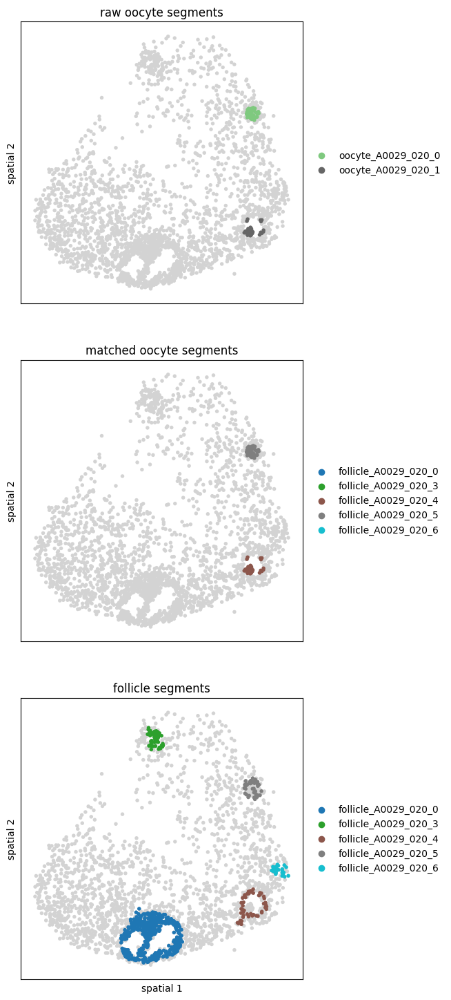

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


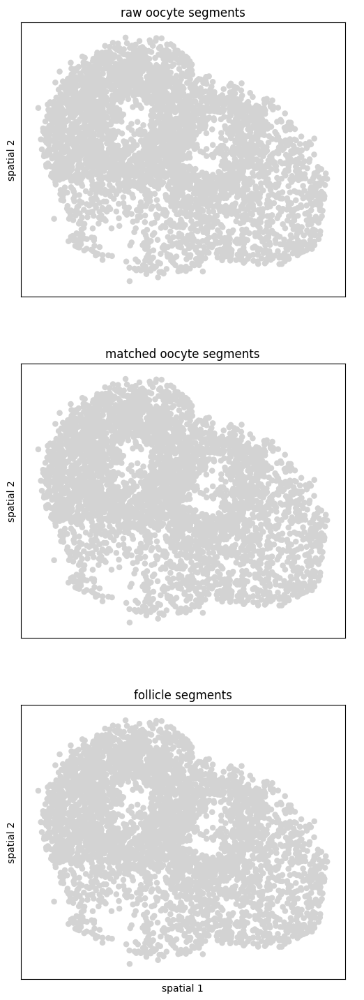

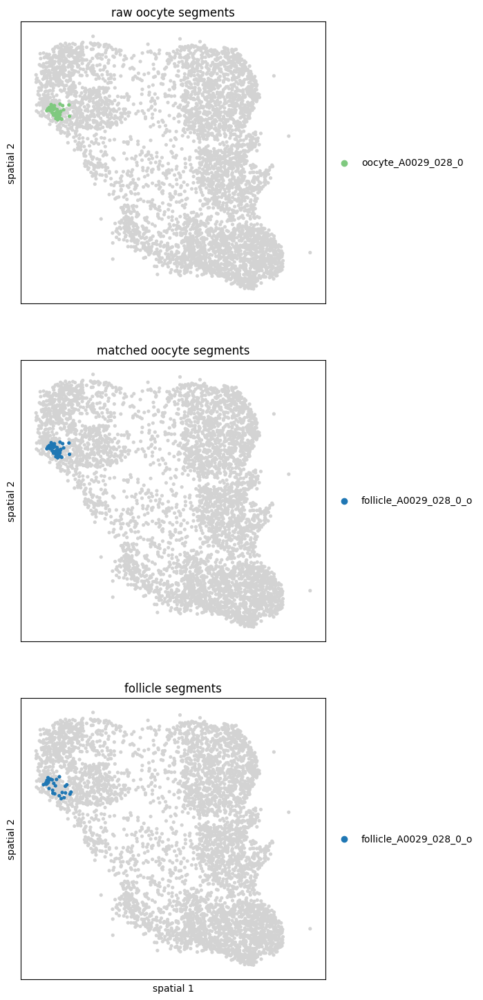

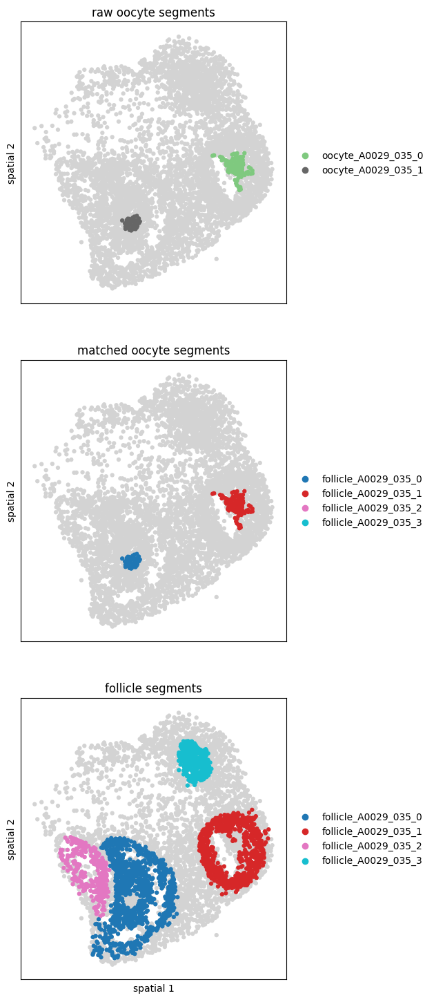

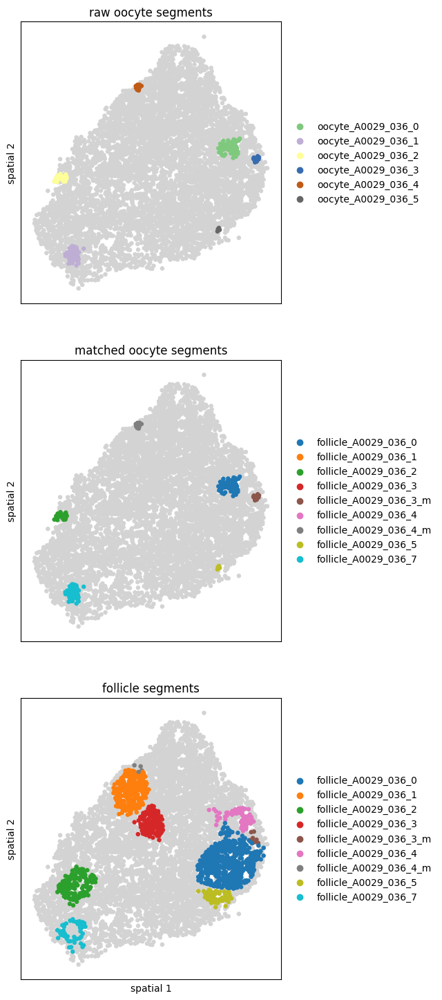

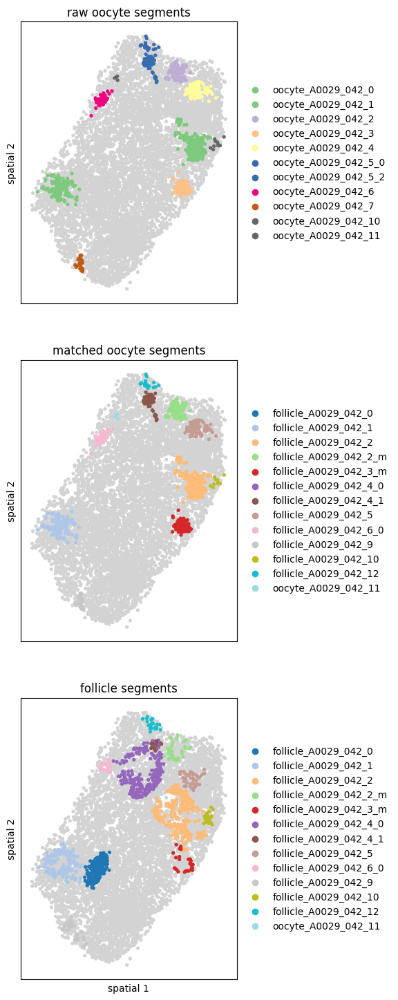

...

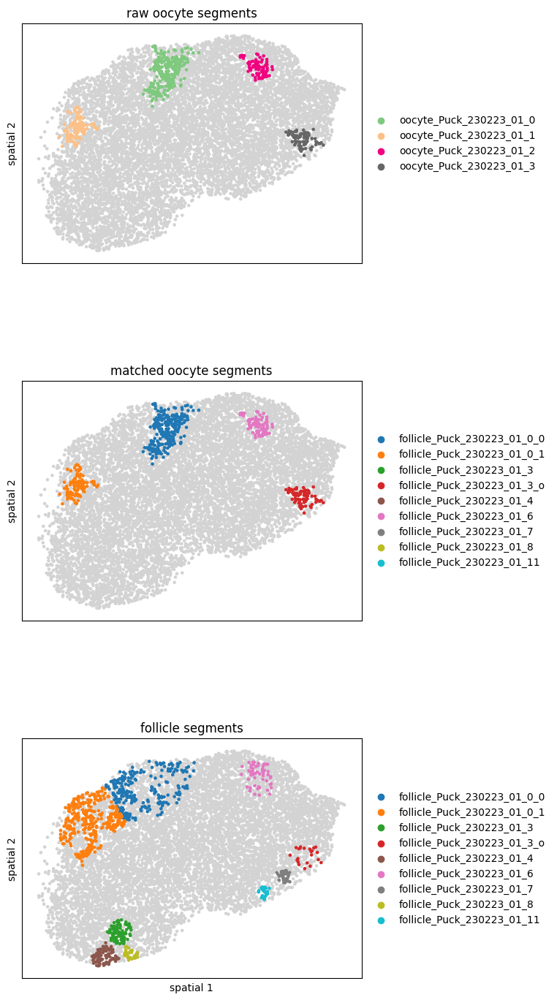

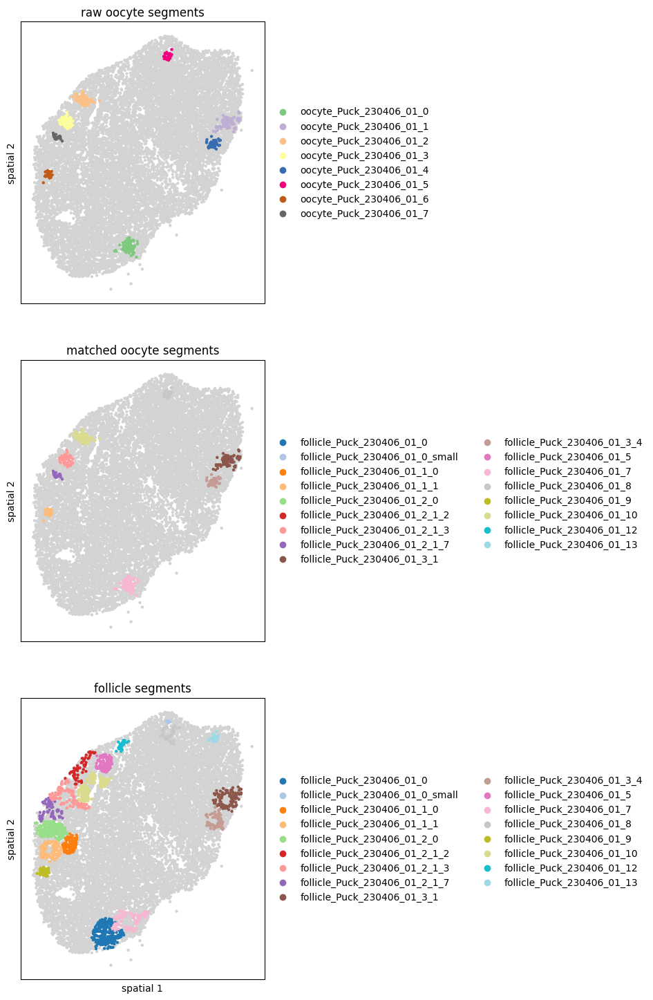

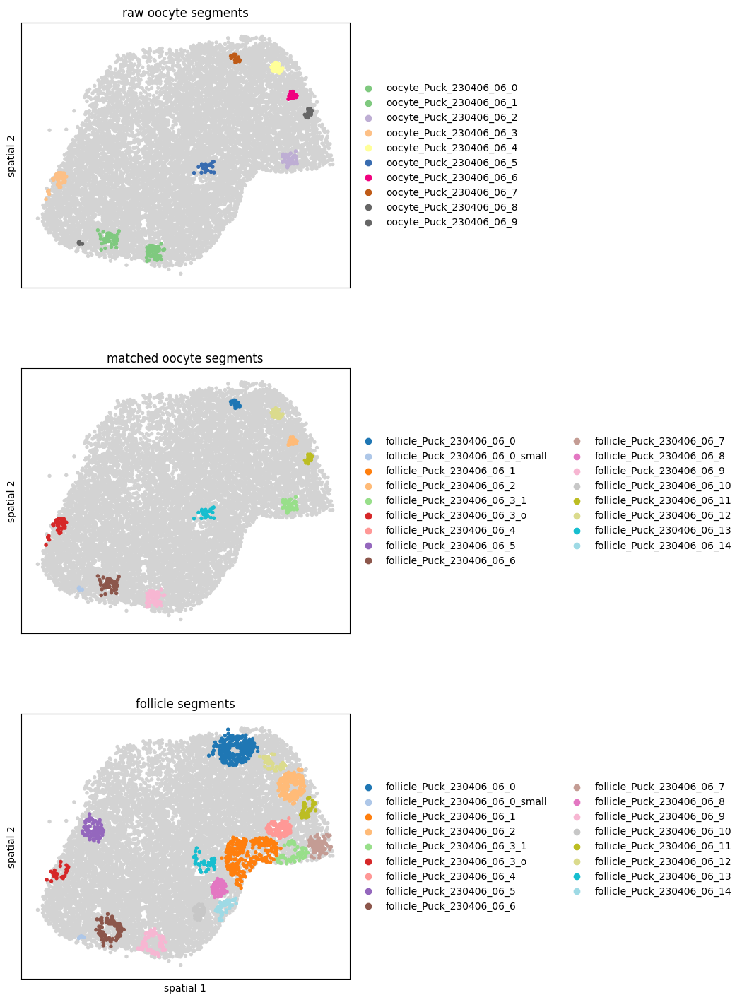

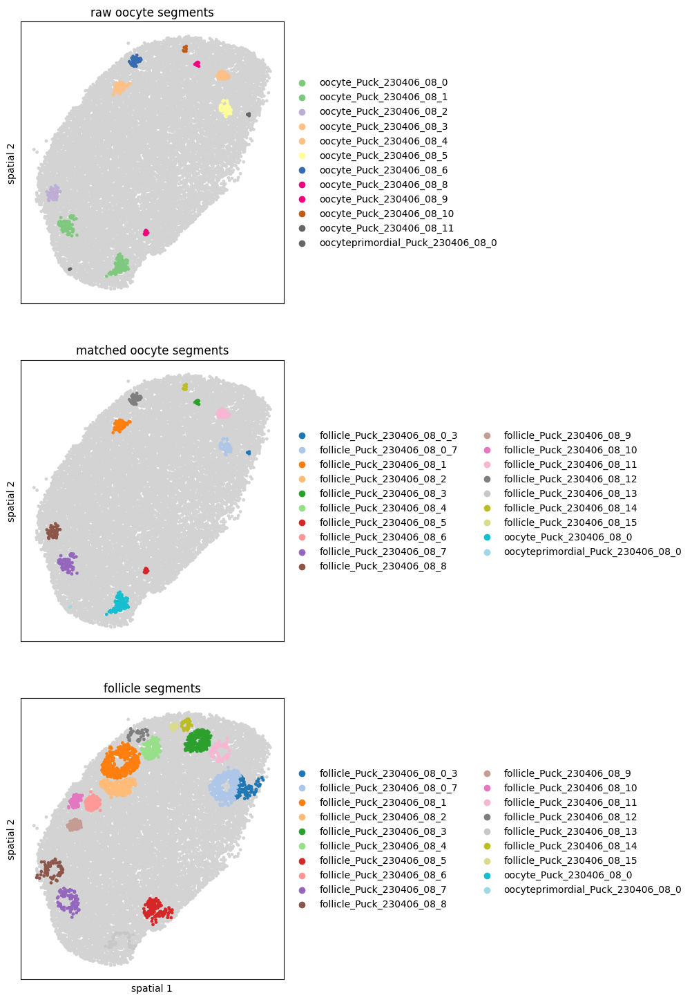

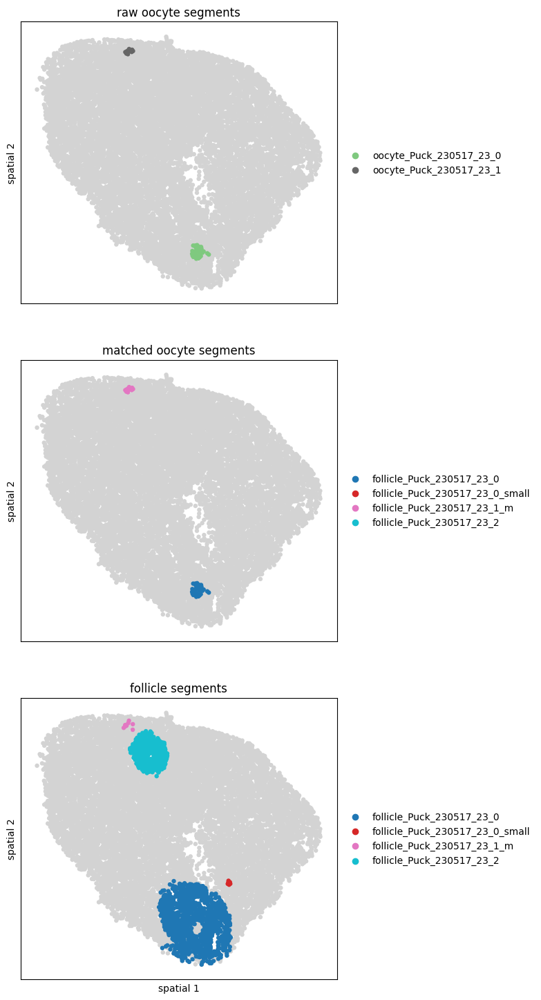

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


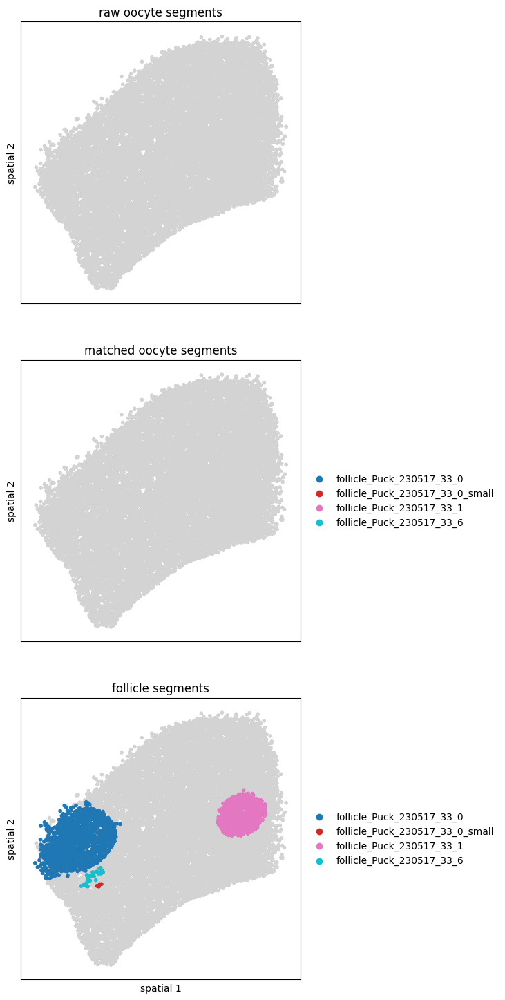

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


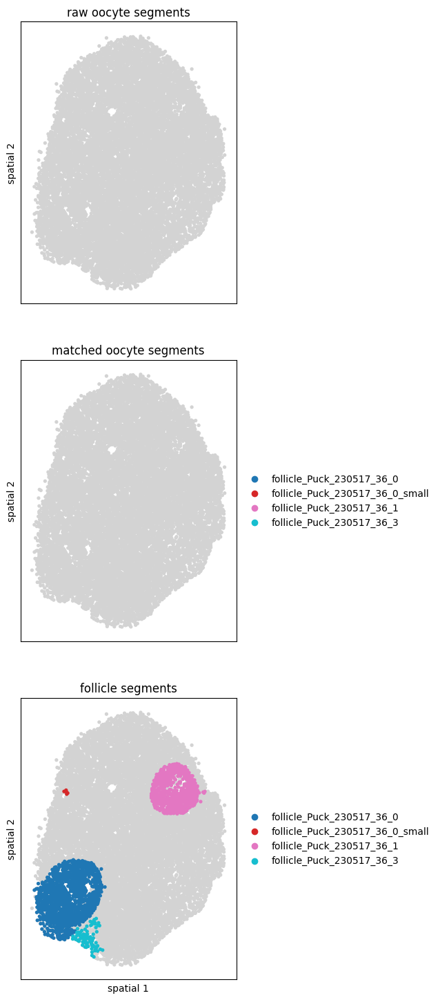

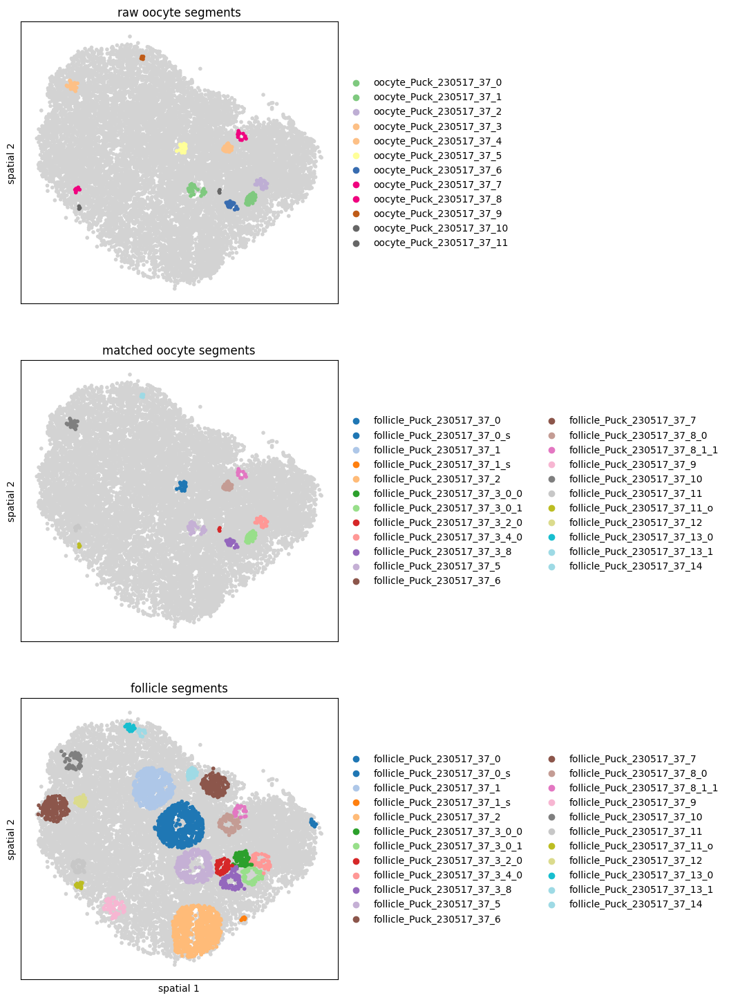

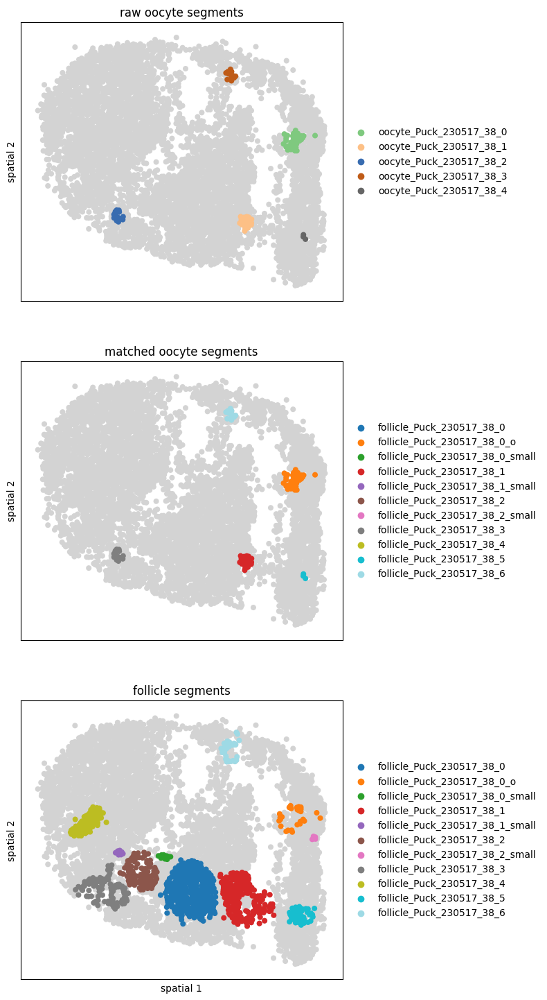

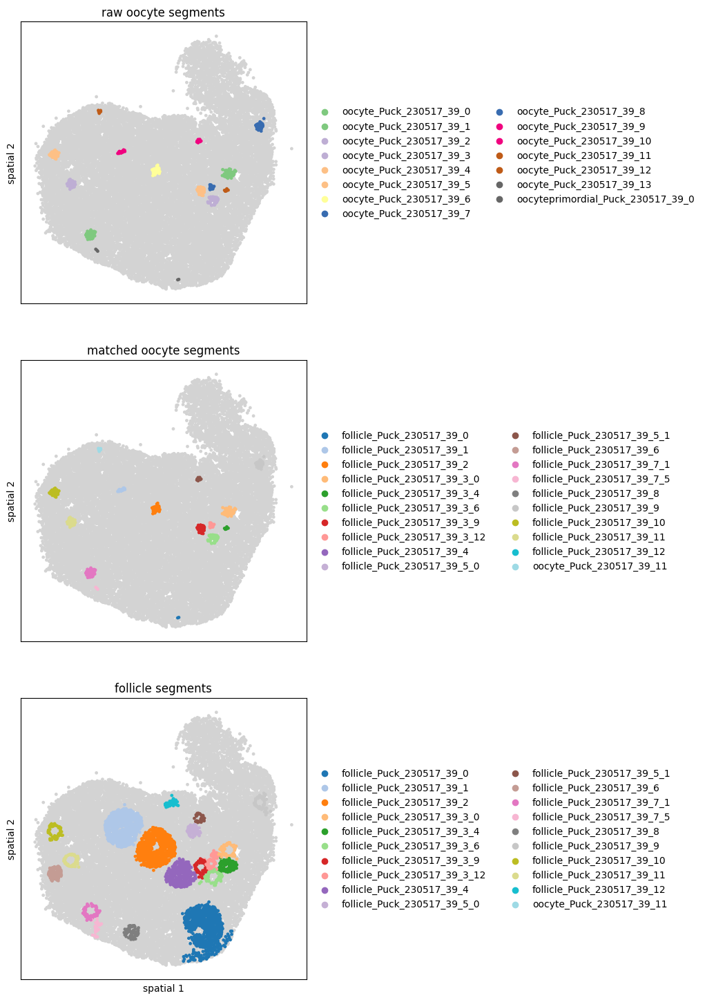

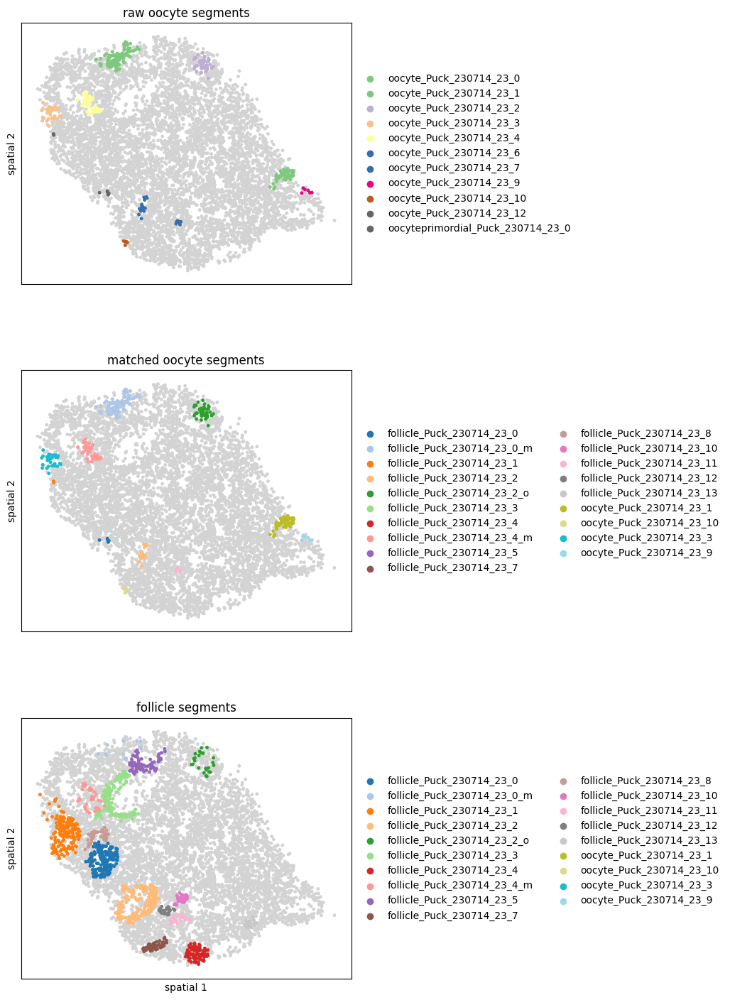

...

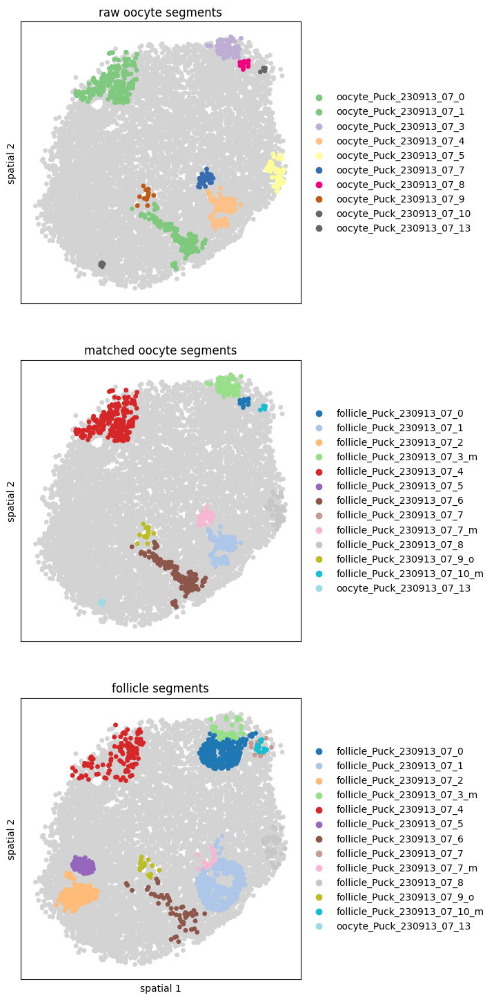

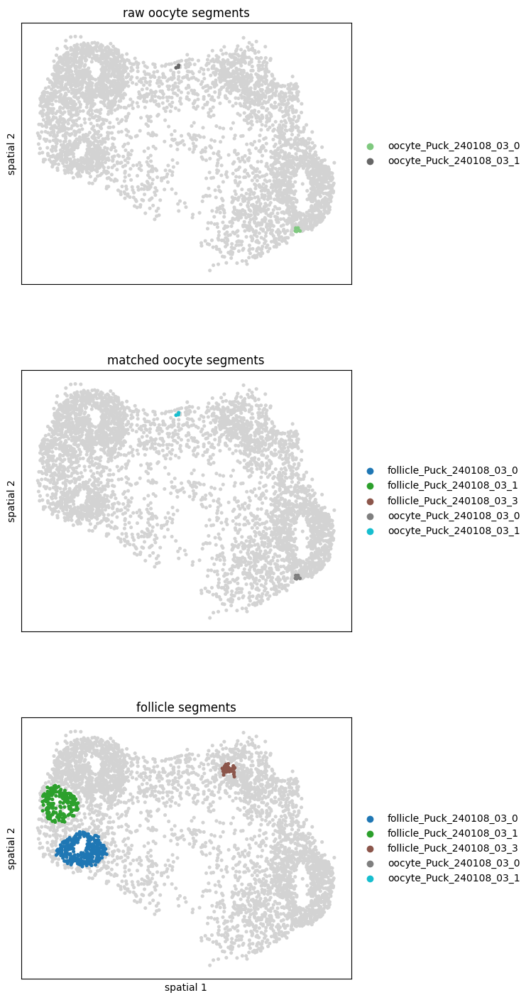

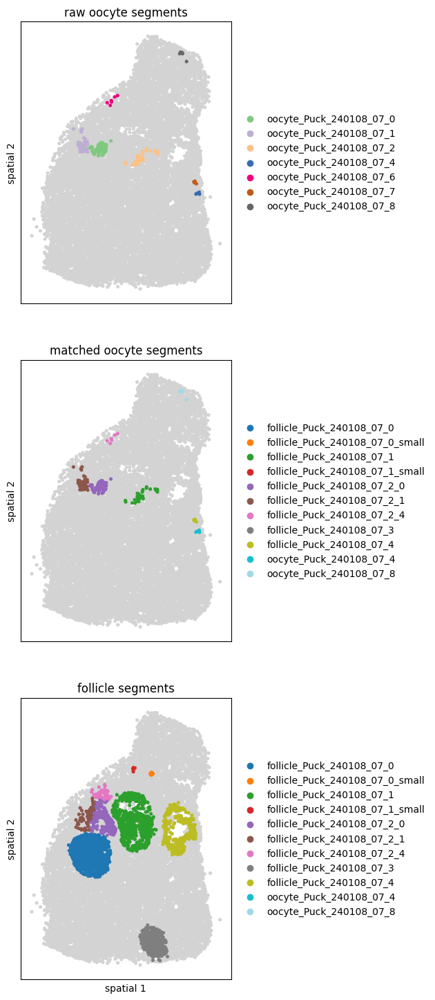

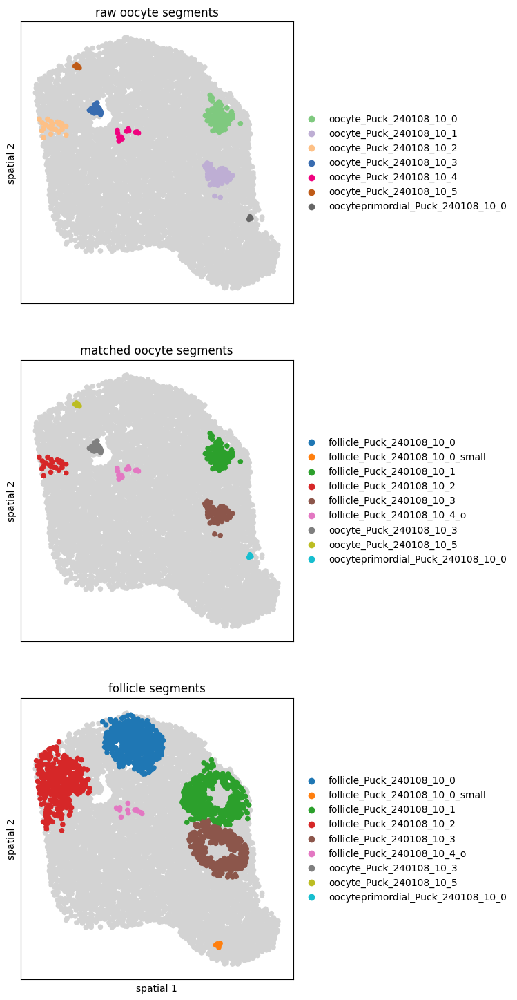

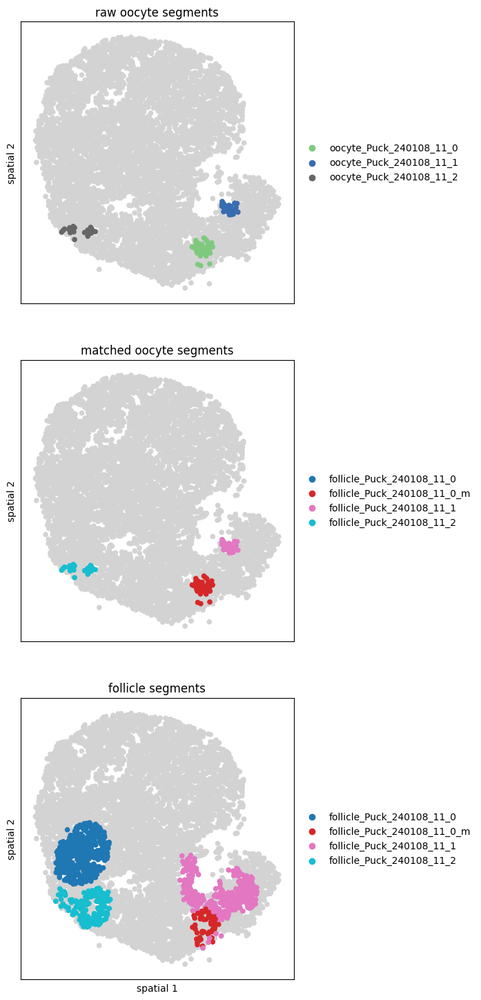

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


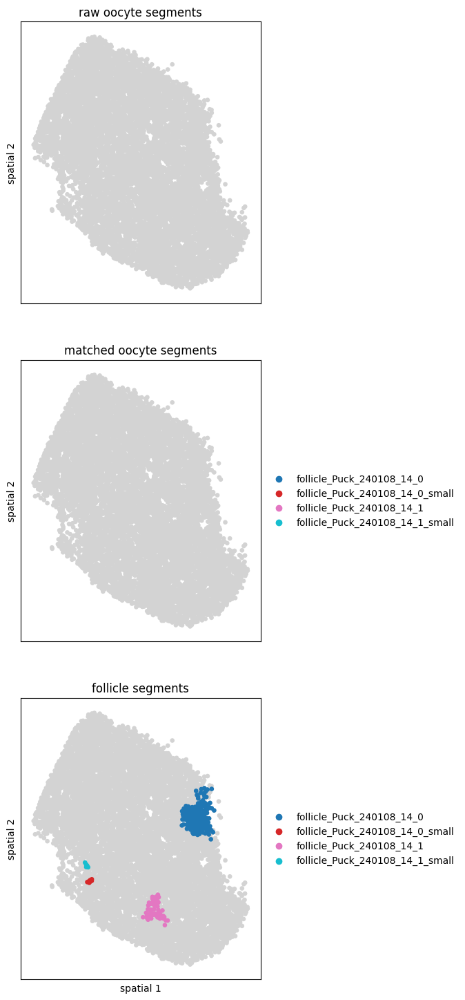

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


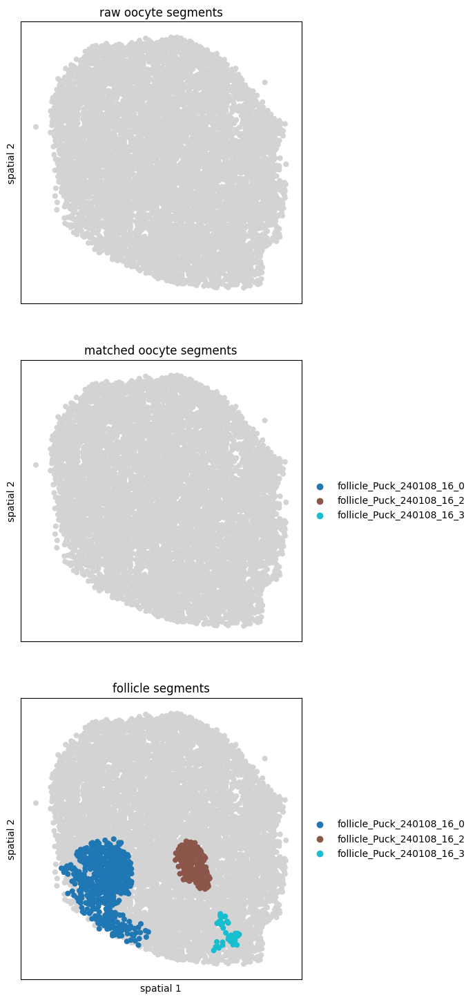

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


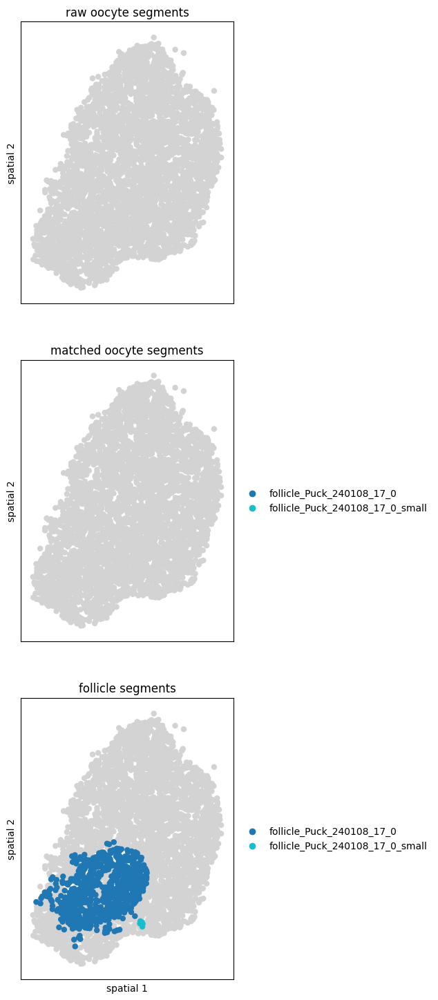

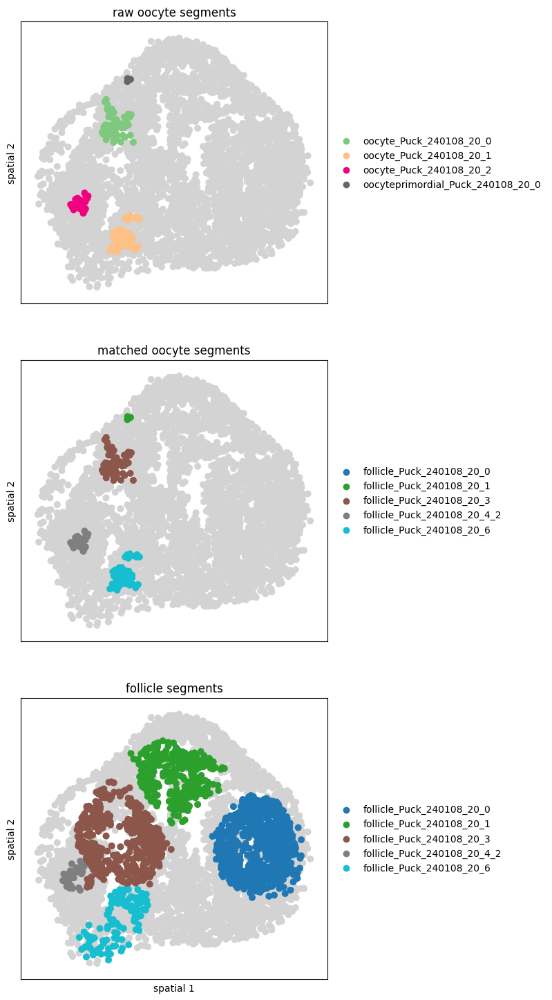

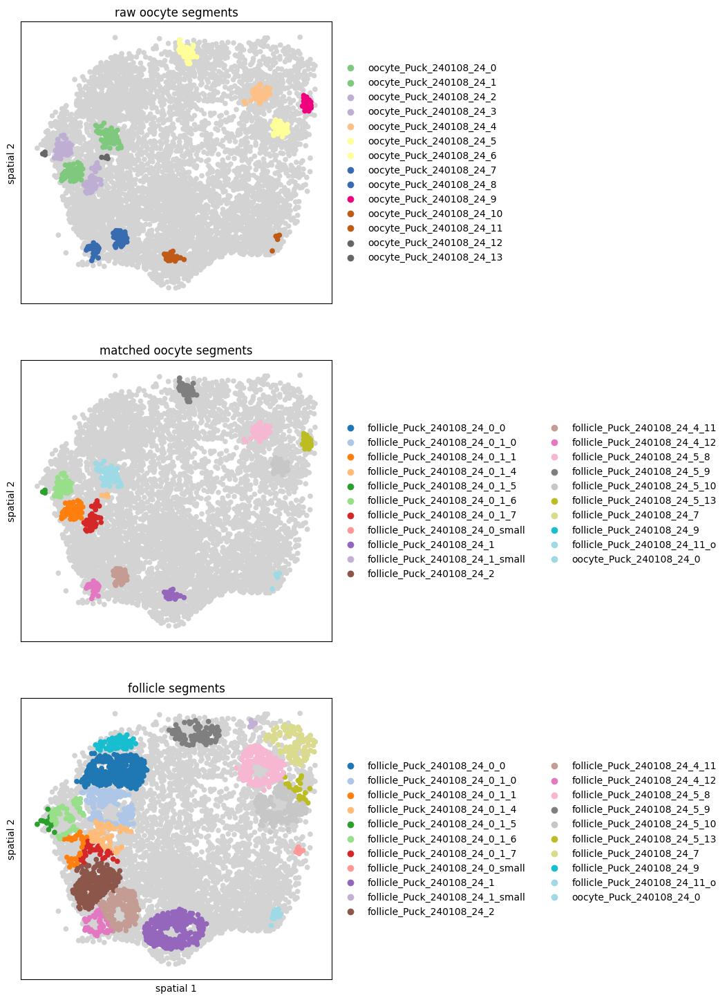

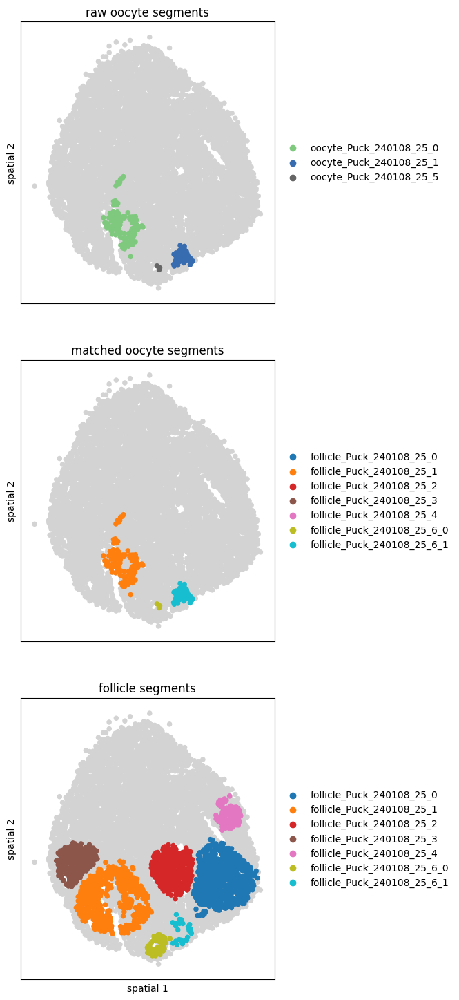

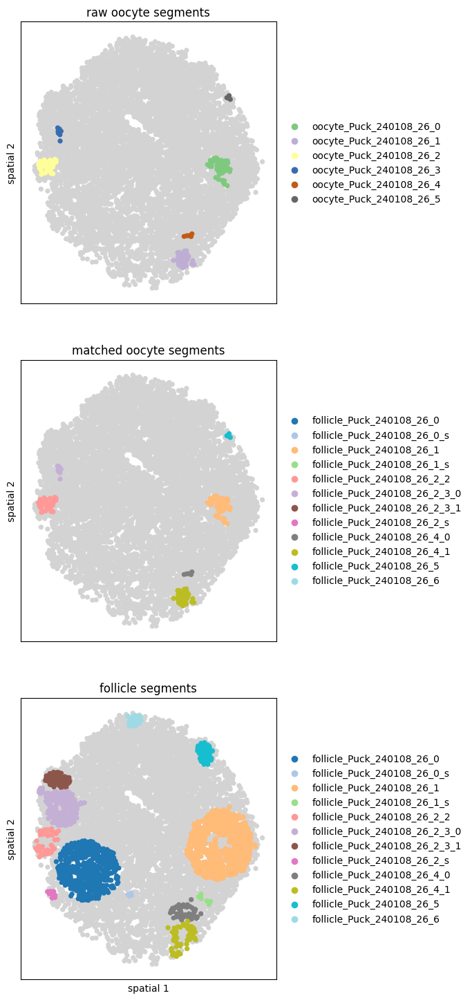

...

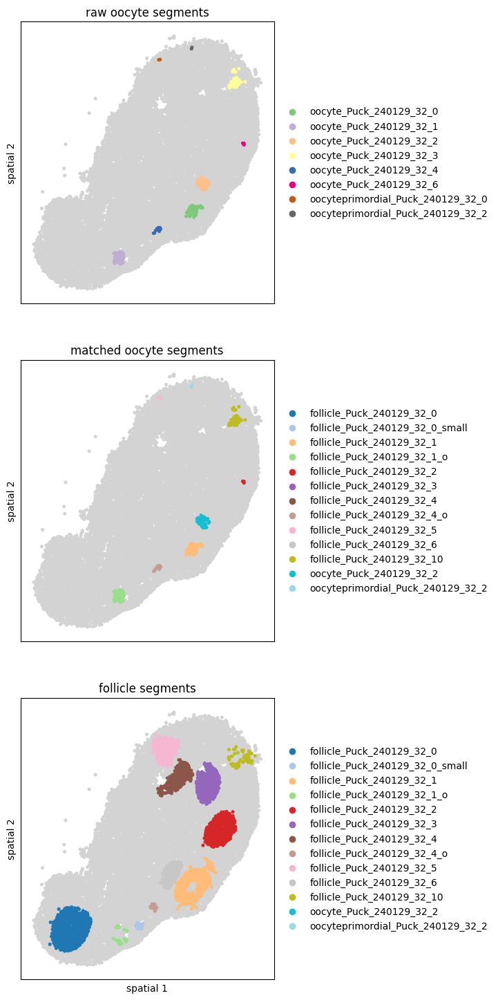

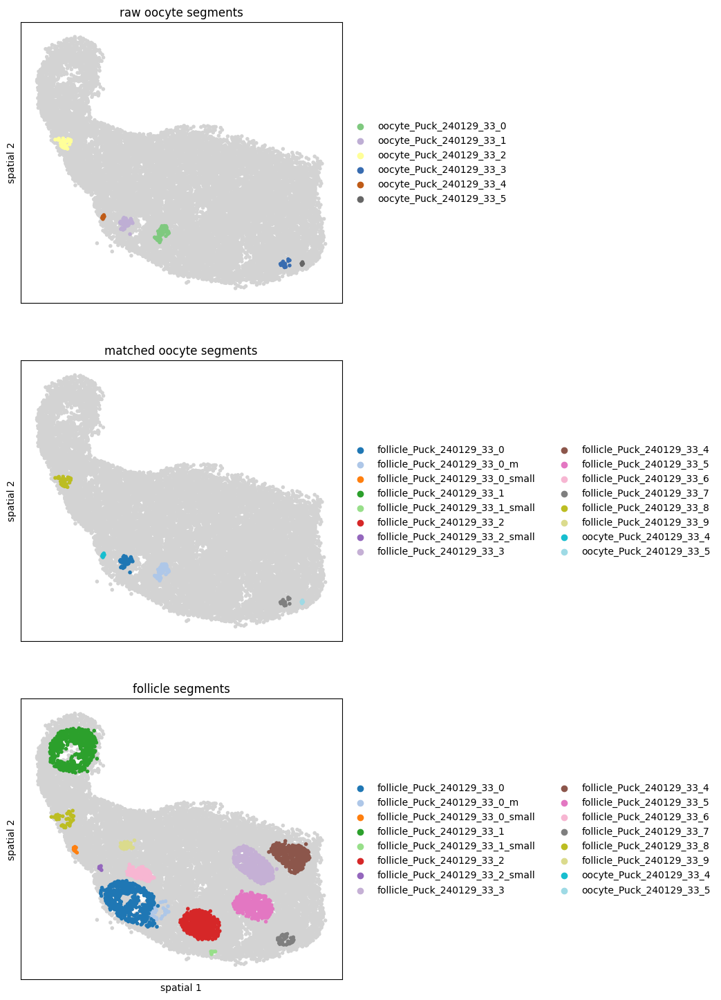

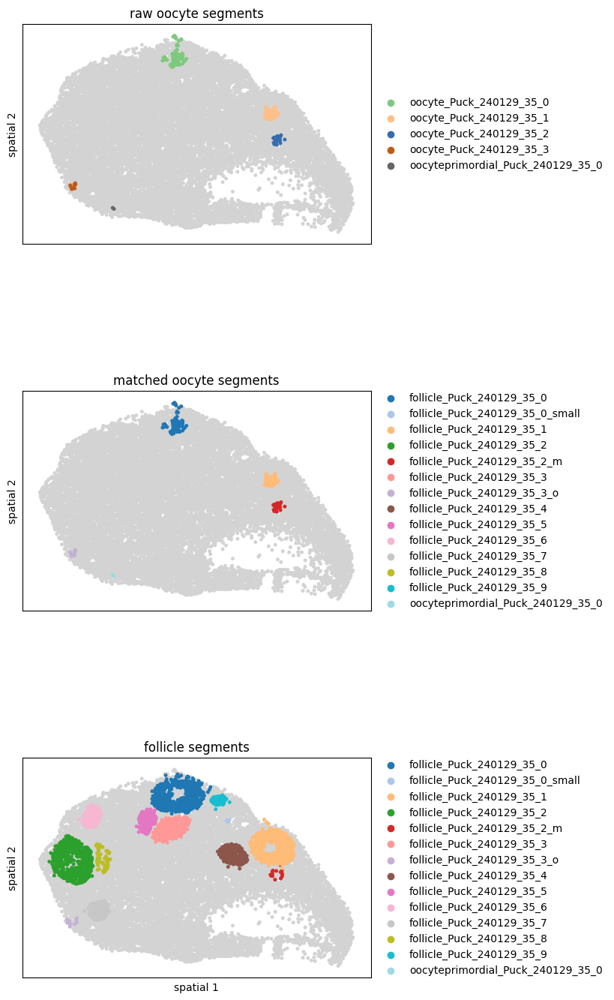

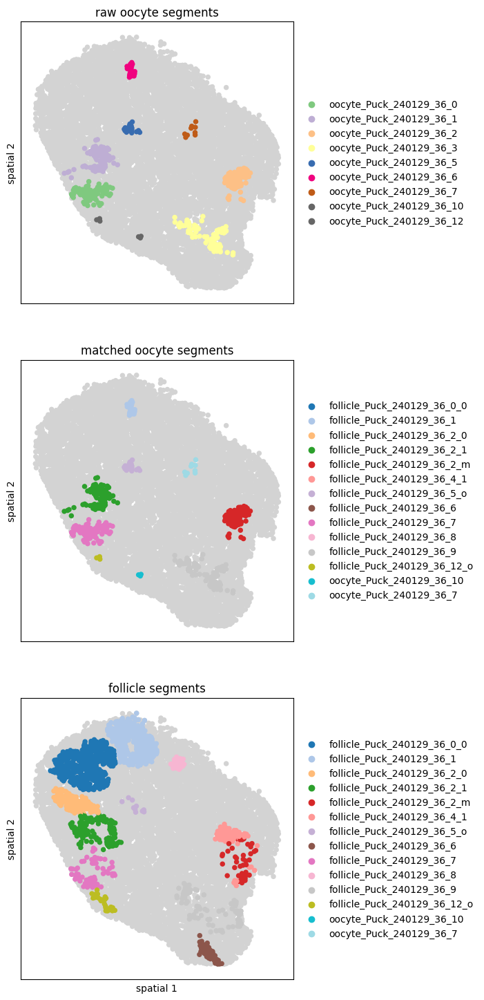

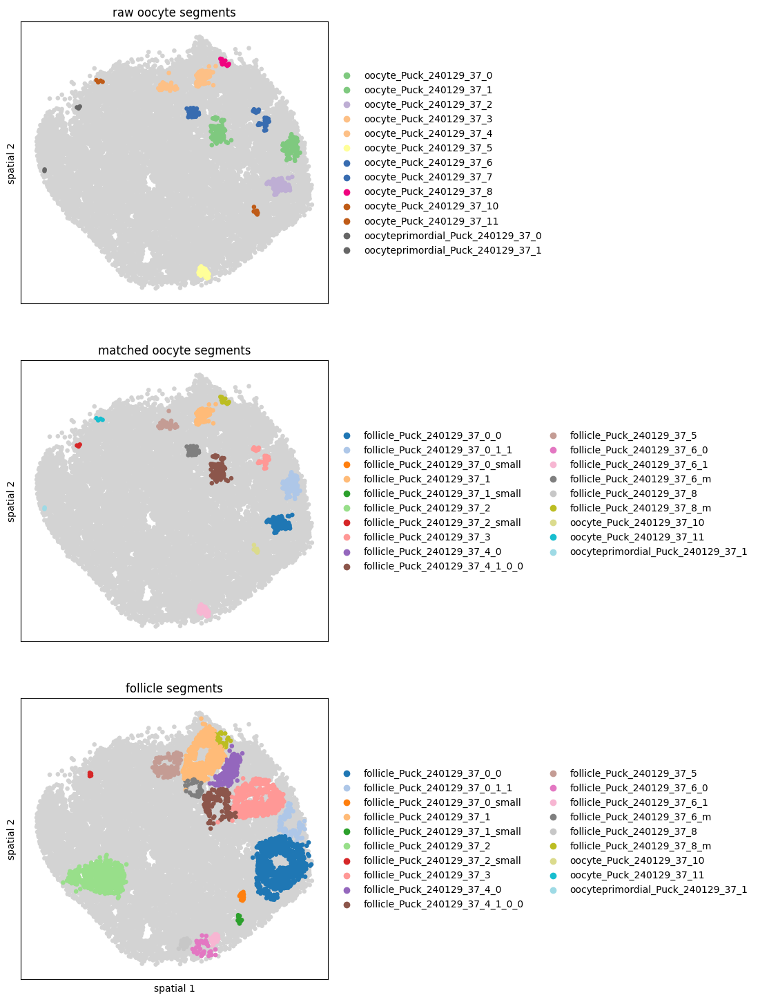

In [69]:
for puck in pucks:
    plot_oocyte_matching(x=puck, adata=adata_spots, show=True)

## Manual correction

In [70]:
# Assign oocyte to different follicle:
manual_correction = {
    "follicle_A0029_036_0": "follicle_A0029_036_4",
    "follicle_PM104_004_6": "follicle_PM104_004_12",
    "follicle_Puck_230406_01_10": "follicle_Puck_230406_01_2_1_2",
}
adata_spots.obs["id_oocyte_matched"] = [
    manual_correction[x] if x in manual_correction.keys() else x
    for x in adata_spots.obs["id_oocyte_matched"].values
]

In [71]:
# Remove matching for these oocytes:
isolated_oocytes = [
    "oocyteprimordial_Puck_240108_20_0",
    "oocyte_Puck_230714_29_5",
    "oocyte_Puck_230714_39_8",
    "oocyte_Puck_230807_27_3",
    "oocyte_Puck_240129_32_6",
]
adata_spots.obs["id_oocyte_matched"] = [
    x if x in isolated_oocytes else y
    for x, y in zip(
        adata_spots.obs["id_oocyte"].values,
        adata_spots.obs["id_oocyte_matched"].values
    )
]

## Add oocyte matching into other objects

In [72]:
adata_segments.obs['count_oocyte'] = [
    np.sum(np.logical_and(
        adata_spots.obs["segment_id"].values == x,
        adata_spots.obs["segment_layer"].values == "oocyte",
    ))
    for x in adata_segments.obs_names
]

In [73]:
for x in ["count_oocyte"]:
    adata_segments.obs[f"{x}_log10"] = np.log(adata_segments.obs[x].values + 1) / np.log(10)

In [74]:
for x in ["segment_label", "segment_label_coarse", "segment_type"]:
    adata_spots.obs[x] = [
        y if y != "other" else
        adata_spots[adata_spots.obs["segment_id"].values == id_oocyte_matched].obs[x].values[0] 
        if id_oocyte_matched in adata_segments.obs_names else "other"
        for y, id_oocyte_matched in zip(
            adata_spots.obs[x].values,
            adata_spots.obs["id_oocyte_matched"].values,
        )
    ]
for x in ["segment_id"]:
    adata_spots.obs[x] = [
        y if y != "other" else
        id_oocyte_matched if id_oocyte_matched in adata_segments.obs_names else "other"
        for y, id_oocyte_matched in zip(
            adata_spots.obs[x].values,
            adata_spots.obs["id_oocyte_matched"].values,
        )
    ]
for x in ["segment_layer"]:
    adata_spots.obs[x] = [
        y if y != "other" else
        "oocyte" if id_oocyte_matched in adata_segments.obs_names else "other"
        for y, id_oocyte_matched in zip(
            adata_spots.obs[x].values,
            adata_spots.obs["id_oocyte_matched"].values,
        )
    ]

In [75]:
for k in ["granulosa", "immune", "vascular", "theca", "oocyte"]:  # need to add in oocyte count and update other counts also for assigned oocyte spots
    size_map = {
        x: np.sum(np.logical_and(
            adata_spots.obs["segment_id"].values == x,
            adata_spots.obs["segment_layer"].values == k,
        ))
        for x in np.unique(adata_spots.obs["segment_id"].values)
        if x != "other"
    }
    adata_spots.obs[f'segment_count_{k}'] = [
        size_map[x] if x in size_map.keys() else 0
        for x in adata_spots.obs["segment_id"].values    
    ]

# Assemble full follicle and CL segments

In [76]:
adata_spots.obs["segment_id_extended"] = [
    segment_id if segment_id != "other" else
    id_mesenchyme if id_mesenchyme != "other" else "other"
    for (
        segment_id,
        id_mesenchyme,
    ) in zip(
        adata_spots.obs["segment_id"].values,
        adata_spots.obs["id_mesenchyme"].values,
    )
]
adata_spots.obs["segment_layer_extended"] = [
    segment_layer if segment_layer != "other" else
    "mesenchyme" if id_mesenchyme != "other" else "other"
    for (
        segment_layer,
        id_mesenchyme
    ) in zip(
        adata_spots.obs["segment_layer"].values,
        adata_spots.obs["id_mesenchyme"].values,
    )
]
segements_with_oocyte = [
    x for x in np.unique(adata_spots.obs["id_oocyte_matched"].values)
    if x.startswith("follicle")
]
adata_spots.obs["segment_has_oocyte"] = [
    x in segements_with_oocyte for x in adata_spots.obs["segment_id"].values
]

## Save final plots

In [77]:
for puck in pucks:
    plot_oocyte_matching(x=puck, adata=adata_spots, show=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

# Changes across segment states

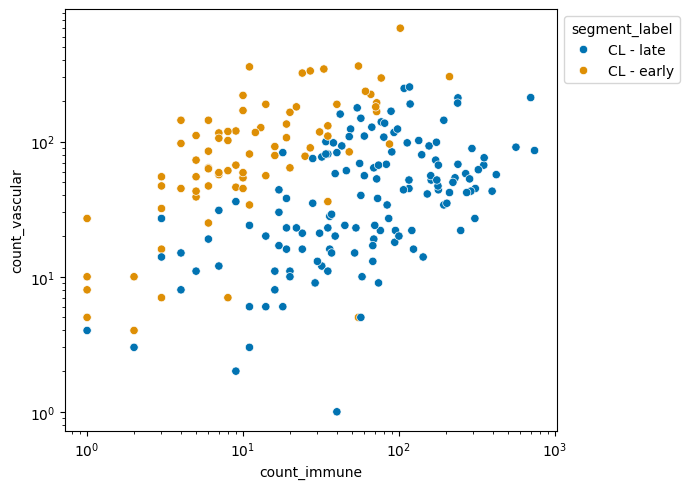

In [78]:
for relative in [False]:
    tab = adata_segments.obs.loc[
    [x in ["CL - late", "CL - early"] for x in adata_segments.obs["segment_label"].values],
        ['count_granulosa', 'count_immune', 'count_vascular']
    ]
    if relative:
        tab = tab / tab.values.sum(1, keepdims=True)
    tab["segment_label"] = adata_segments.obs.loc[tab.index, "segment_label"].values.tolist()
    tab["stage"] = adata_segments.obs.loc[tab.index, "stage"]

    fig, ax = plt.subplots(figsize=(7, 5))
    sb.scatterplot(
        data=tab,
        x="count_immune", y="count_vascular", hue="segment_label", 
        legend=True,
        palette="colorblind", 
        ax=ax
    )
    if not relative:
        ax.set_xscale("log")
        ax.set_yscale("log")
    sb.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, f"scatterplot_composition_by_cl_cluster{'_relative' if relative else ''}.pdf"))
    plt.show()

/var/folders/_p/kz9b3cxj78bg4jn_1cx4ckp40000gq/T/ipykernel_45616/2519566075.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tab["segment_label"] = pd.Categorical(


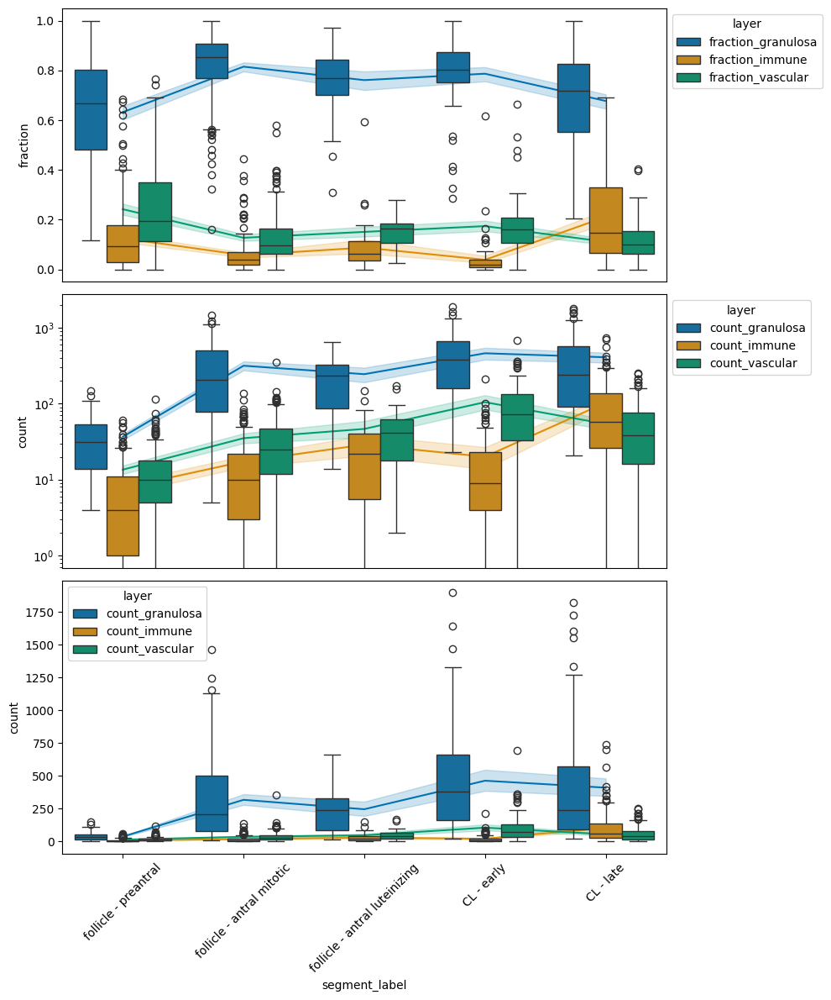

In [79]:
segments_include = [
    "follicle - preantral",
    "follicle - antral mitotic",
    "follicle - antral luteinizing",
    "CL - early", 
    "CL - late"]
tab = adata_segments[[
    x in segments_include
    for x in adata_segments.obs["segment_label"].values
]].obs[[
    'count_granulosa', 'count_immune', 'count_vascular', "segment_label"
]]
tab["segment_label"] = pd.Categorical(
    tab["segment_label"].values.tolist(),
    categories=segments_include
)
tab_frac = tab.copy()
for x in ["granulosa", "immune", "vascular"]: 
    tab_frac[f"fraction_{x}"] = tab_frac[f"count_{x}"].values / (
        tab_frac["count_granulosa"].values + tab_frac["count_immune"].values + tab_frac["count_vascular"].values
    )
for x in ["granulosa", "immune", "vascular"]:
    del tab_frac[f"count_{x}"]
tab = tab.melt(id_vars="segment_label", value_name="count", var_name="layer")
tab_frac = tab_frac.melt(id_vars="segment_label", value_name="fraction", var_name="layer")

fig, ax = plt.subplots(nrows=3, figsize=(10, 12))
i = 0
sb.lineplot(
    data=tab_frac,
    x="segment_label", y="fraction", hue="layer", 
    legend=False,
    palette="colorblind",
    ax=ax[i]
)
sb.boxplot(
    data=tab_frac,
    x="segment_label", y="fraction", hue="layer",
    palette="colorblind",
    ax=ax[i]
)
for i in range(2):
    sb.lineplot(
        data=tab,
        x="segment_label", y="count", hue="layer", 
        legend=False,
        palette="colorblind",
        ax=ax[i+1]
    )
    sb.boxplot(
        data=tab,
        x="segment_label", y="count", hue="layer",
        palette="colorblind",
        ax=ax[i+1]
    )
    if i == 1:
        ax[i].set_yscale("log")
    sb.move_legend(ax[i], "upper left", bbox_to_anchor=(1, 1))
ax[0].set_xticks([])
ax[0].set_xlabel("")
ax[1].set_xticks([])
ax[1].set_xlabel("")
ax[2].tick_params(axis='x', labelrotation=45)
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, "boxplot_composition_by_label.pdf"))
plt.show()

/var/folders/_p/kz9b3cxj78bg4jn_1cx4ckp40000gq/T/ipykernel_45616/256035507.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tab["segment_label"] = pd.Categorical(


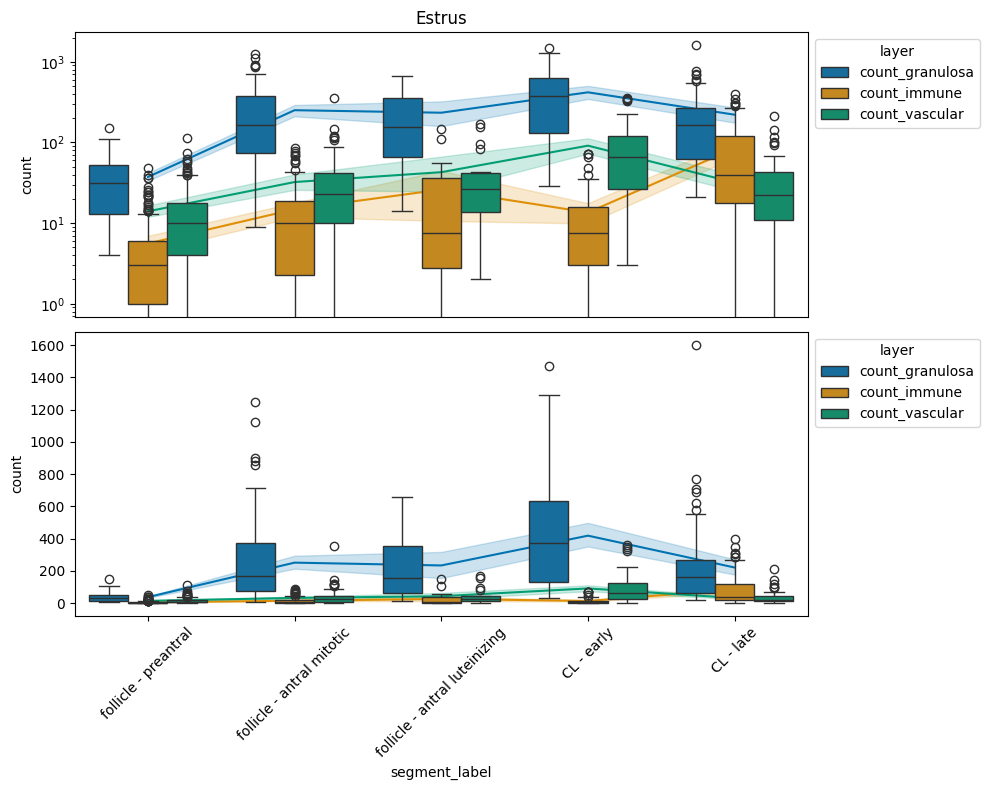

/var/folders/_p/kz9b3cxj78bg4jn_1cx4ckp40000gq/T/ipykernel_45616/256035507.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tab["segment_label"] = pd.Categorical(


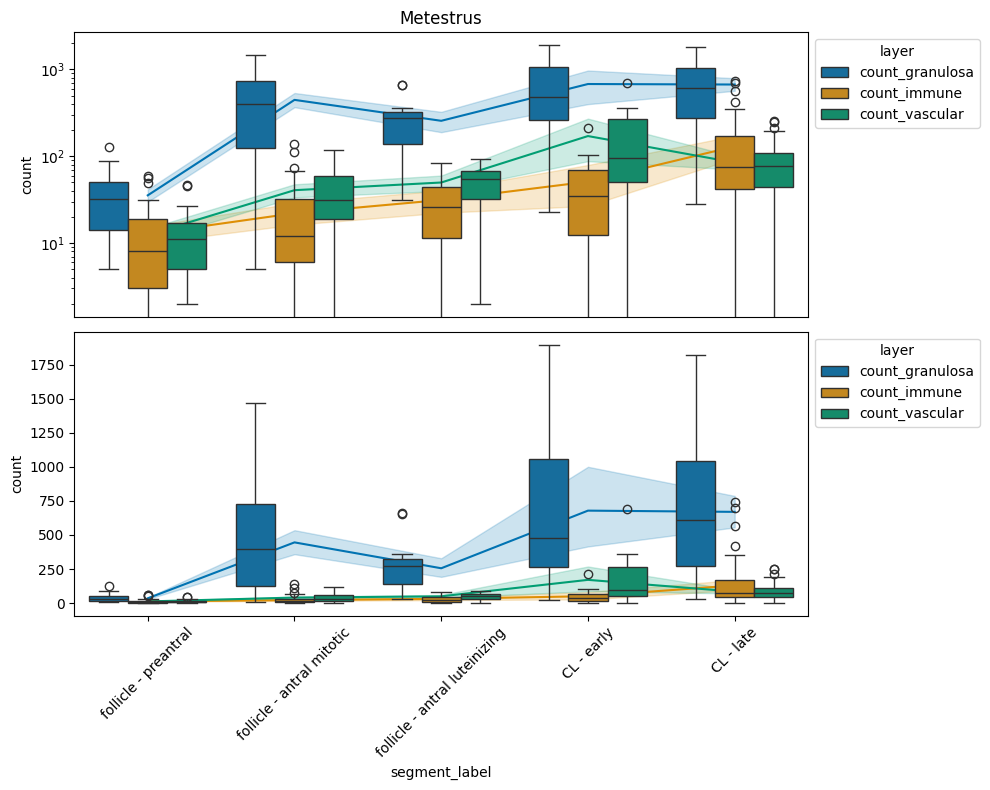

In [80]:
for s in ["Estrus", "Metestrus"]:
    tab = adata_segments[np.logical_and(
        adata_segments.obs["stage"].values == s,
        [
            x in segments_include
            for x in adata_segments.obs["segment_label"].values
        ]
    )].obs[[
        'count_granulosa', 'count_immune', 'count_vascular', "segment_label"
    ]]
    tab["segment_label"] = pd.Categorical(
        tab["segment_label"].values.tolist(),
        categories=segments_include
    )
    tab = tab.melt(id_vars="segment_label", value_name="count", var_name="layer")
    
    fig, ax = plt.subplots(nrows=2, figsize=(10, 8))
    for i in range(2):
        sb.lineplot(
            data=tab,
            x="segment_label", y="count", hue="layer", 
            legend=False,
            palette="colorblind",
            ax=ax[i]
        )
        sb.boxplot(
            data=tab,
            x="segment_label", y="count", hue="layer",
            palette="colorblind",
            ax=ax[i]
        )
        if i == 0:
            ax[i].set_yscale("log")
        sb.move_legend(ax[i], "upper left", bbox_to_anchor=(1, 1))
    ax[0].set_title(s)
    ax[0].set_xticks([])
    ax[0].set_xlabel("")
    ax[1].tick_params(axis='x', labelrotation=45)
    plt.tight_layout()
    plt.savefig(os.path.join(figure_folder, f"boxplot_composition_by_label_{s.lower()}.pdf"))
    plt.show()

# Global stats

## Hormone expression summaries

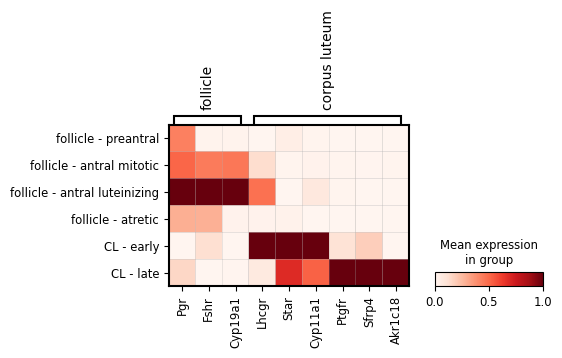

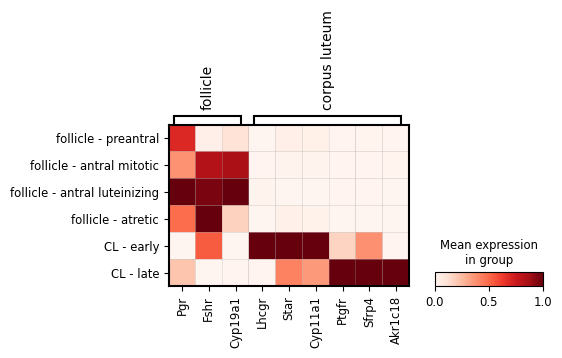

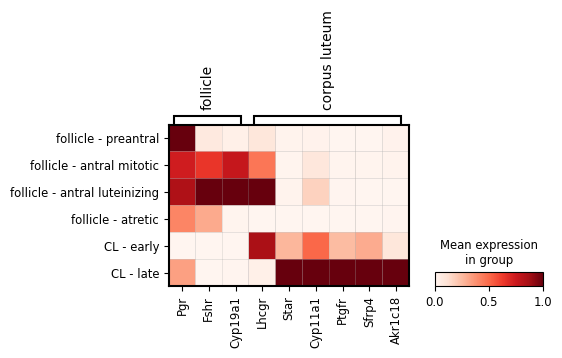

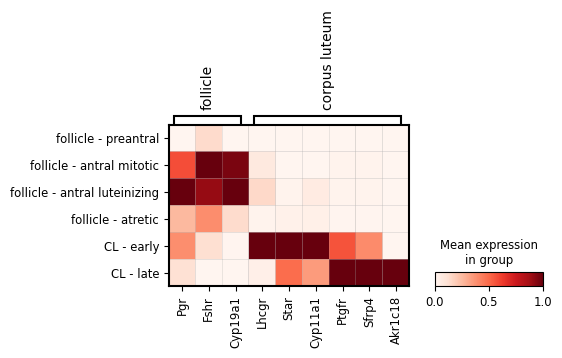

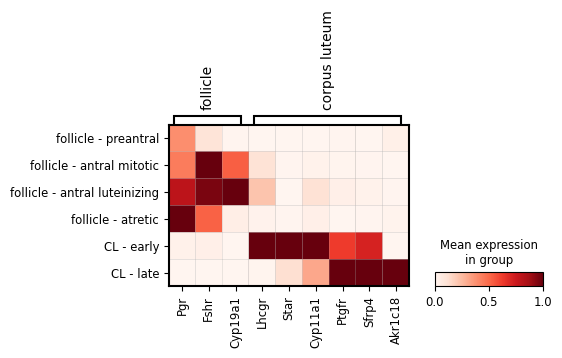

In [82]:
vars_hormones = {
    "follicle": ["Pgr", "Fshr", "Cyp19a1"], 
    "corpus luteum": ["Lhcgr", "Star", "Cyp11a1", "Ptgfr", "Sfrp4", "Akr1c18"]
}

adata_ = adata_spots[np.logical_and.reduce([
    adata_spots.obs["Age"].values == "Young",
    [x in ["oocyte", "granulosa", "theca"] 
     for x in adata_spots.obs["segment_layer"].values],
])].copy()
adata_.obs["segment_label"] = pd.Categorical(
    adata_.obs["segment_label"].values,
    categories=label_levels,
)
sc.pl.matrixplot(
    adata_,
    groupby="segment_label", var_names=vars_hormones,
    use_raw=True, standard_scale="var", cmap="Reds",
    save="hormone_expression_segment_young_all.pdf"
)

adata_ = adata_spots[np.logical_and.reduce([
    adata_spots.obs["Age"].values == "Young",
    adata_spots.obs["stage"].values == "Estrus",
    [x in ["oocyte", "granulosa", "theca"] 
     for x in adata_spots.obs["segment_layer"].values],
])].copy()
adata_.obs["segment_label"] = pd.Categorical(
    adata_.obs["segment_label"].values,
    categories=label_levels,
)
sc.pl.matrixplot(
    adata_,
    groupby="segment_label", var_names=vars_hormones,
    use_raw=True, standard_scale="var", cmap="Reds",
    save="hormone_expression_segment_young_estrus.pdf"
)

adata_ = adata_spots[np.logical_and.reduce([
    adata_spots.obs["Age"].values == "Young",
    adata_spots.obs["stage"].values == "Metestrus",
    [x in ["oocyte", "granulosa", "theca"] 
     for x in adata_spots.obs["segment_layer"].values],
])].copy()
adata_.obs["segment_label"] = pd.Categorical(
    adata_.obs["segment_label"].values,
    categories=label_levels,
)
sc.pl.matrixplot(
    adata_,
    groupby="segment_label", var_names=vars_hormones,
    use_raw=True, standard_scale="var", cmap="Reds",
    save="hormone_expression_segment_young_metestrus.pdf"
)

adata_ = adata_spots[np.logical_and.reduce([
    adata_spots.obs["Age"].values == "Old",
    adata_spots.obs["stage"].values == "Estrus",
    [x in ["oocyte", "granulosa", "theca"] 
     for x in adata_spots.obs["segment_layer"].values],
])].copy()
adata_.obs["segment_label"] = pd.Categorical(
    adata_.obs["segment_label"].values,
    categories=label_levels,
)
sc.pl.matrixplot(
    adata_,
    groupby="segment_label", var_names=vars_hormones,
    use_raw=True, standard_scale="var", cmap="Reds",
    save="hormone_expression_segment_old_estrus.pdf"
)

adata_ = adata_spots[np.logical_and.reduce([
    adata_spots.obs["Age"].values == "Old",
    adata_spots.obs["stage"].values == "Metestrus",
    [x in ["oocyte", "granulosa", "theca"] 
     for x in adata_spots.obs["segment_layer"].values],
])].copy()
adata_.obs["segment_label"] = pd.Categorical(
    adata_.obs["segment_label"].values,
    categories=label_levels,
)
sc.pl.matrixplot(
    adata_,
    groupby="segment_label", var_names=vars_hormones,
    use_raw=True, standard_scale="var", cmap="Reds",
    save="hormone_expression_segment_old_metestrus.pdf"
)

del adata_

## Cell cycle score

In [83]:
cell_cycle_genes = [x.strip() for x in open(fn_cc)]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

adata_spots_granulosa = adata_spots[np.logical_and.reduce([
    adata_spots.obs["Age"].values == "Young",
    adata_spots.obs["segment_layer"].values == "granulosa"
])].copy()

cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_spots_granulosa.var_names]
sc.pp.log1p(adata_spots_granulosa)
sc.pp.scale(adata_spots_granulosa)
sc.tl.score_genes_cell_cycle(adata_spots_granulosa, s_genes=s_genes, g2m_genes=g2m_genes)

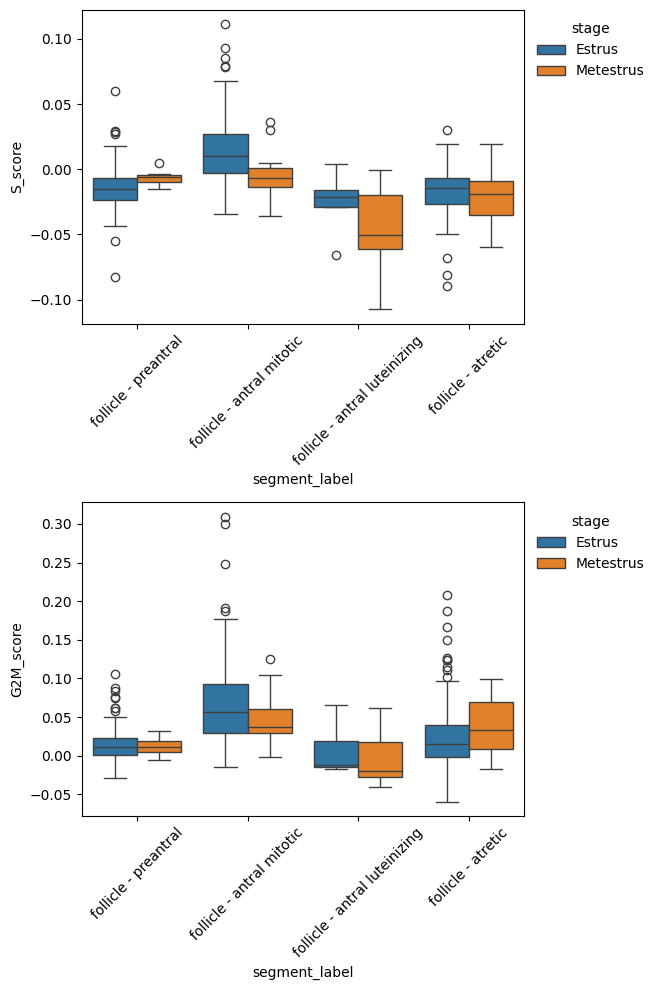

In [84]:
scores = ['S_score', 'G2M_score']
adata_ = adata_spots_granulosa[np.logical_and.reduce([
    adata_spots_granulosa.obs["Age"].values == "Young",
    [x in ["oocyte", "granulosa", "theca"] 
     for x in adata_spots_granulosa.obs["segment_layer"].values],
    [x == "follicle"
     for x in adata_spots_granulosa.obs["segment_type"].values.tolist()],
])].copy()
adata_.obs["segment_label"] = pd.Categorical(
    adata_.obs["segment_label"].values,
    categories=label_levels[:-2],
)
id_vars = ["segment_id", "segment_label", "stage"]
tab = adata_.obs[id_vars + scores].melt(id_vars=id_vars, var_name="phase").\
groupby(id_vars + ["phase"]).\
agg(dict([(x, "first") for x in id_vars + ["phase"]] + [('value', "mean")]))["value"].\
reset_index()
tab = tab.loc[np.logical_not(np.isnan(tab["value"].values)), :].copy()

fig, ax = plt.subplots(nrows=len(scores), ncols=1, figsize=(7, 5 * len(scores)))
for i, x in enumerate(scores):
    sb.boxplot(
        data=tab.loc[tab["phase"].values == x, :],
        x="segment_label", hue="stage", y="value",
        ax=ax[i]
    )
    ax[i].legend(bbox_to_anchor=(1.3, 1), frameon=False, title="stage")
    ax[i].set_ylabel(x)
    ax[i].tick_params(axis='x', labelrotation=45)
plt.tight_layout()
plt.savefig(os.path.join(figure_folder, f"cc_score_by_label_and_stage_clfollicle.pdf"))
plt.show()

# Save summaries

## Save annotation

In [85]:
adata_spots

AnnData object with n_obs × n_vars = 601831 × 5000
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'puck', 'Age', 'n_counts', 'leiden', 'leiden_12', 'cell_type', 'leiden_15', 'is_oocyte', 'id_oocyte', 'is_granulosa', 'granulosa_type', 'id_follicle', 'id_corpusluteum', 'id_proximity_oocyte', 'id_proximity_follicle', 'id_proximity_corpusluteum', 'is_theca', 'id_theca', 'is_mesenchyme', 'id_mesenchyme', 'is_immune', 'id_immune', 'stromal_immune', 'is_vascular', 'id_vascular', 'is_epithelium', 'id_epithelium', 'is_primordial', 'id_primordial', 'oocyte_label', 'new_annot_foll', 'leiden_10', 'leiden_08', 'leiden_06', 'tissue', 'mouse', 'stage', 'batch', 'segment_id', 'segment_layer', 'segment_label', 'segment_label_coarse', 'segment_type', 'segment_count_granulosa', 'segment_count_immune', 'segment_count_vascular', 'segment_count_theca', 'segment_count', 'id_oocyte_matched', 'segment_count_oocyte', 'segment_id_extended', 'segment_layer_extended', 

In [86]:
# Number of follicle & CL segments across ages by state:
adata_spots[adata_spots.obs["segment_id"].values != "other"]\
.obs[["segment_id", "segment_label"]].drop_duplicates()\
.groupby(["segment_label"]).size().reset_index()

,segment_label,0
0,CL - early,87
1,CL - late,147
2,follicle - antral luteinizing,43
3,follicle - antral mitotic,191
4,follicle - atretic,181
5,follicle - preantral,238


In [87]:
# Number of follicle & CL segments across ages by state:
adata_spots[adata_spots.obs["segment_id"].values != "other"]\
.obs[["segment_id", "segment_label"]]\
.groupby(["segment_label"]).size().reset_index()

,segment_label,0
0,CL - early,51181
1,CL - late,83463
2,follicle - antral luteinizing,16446
3,follicle - antral mitotic,81215
4,follicle - atretic,40515
5,follicle - preantral,20913


In [88]:
fn = f"{h5ad_folder}spots_{output_version}_segmented_extended_annotated.h5ad"
adata_spots.write(fn, compression="gzip")

In [90]:
fn = f"{h5ad_folder}/segments_{output_version}_annotated.h5ad"
adata_segments.write(fn, compression="gzip")